# <center>PRÁCTICA 2: APRENDIZAJE SUPERVISADO (DengAI)<center>

**Nombre y apellidos:** Cristian Guerrero Balber

**Usuario VIU:** cguerrerob@student.universidadviu.com

---
# Resumen
---

Esta práctica tiene como objetivo final la consecución de la mejor puntuación posible evaluada con la métrica *MAE (Mean Absolute Error)* sobre la predicción de la cantidad de casos afectados por el virus del Dengue. Es requisito casi indispensable obtener una métrica *mae < 28*. Este problema es parte de una competición organizada por [DrivenData](https://www.drivendata.org/competitions/44/dengai-predicting-disease-spread/page/82/) llamada *DengAI*.

Para conseguirlo, tras un primer proceso de exploración y clusterización de la Actividad 1 donde aún no se estaba teniendo en cuenta a la variable objetivo `total_cases`, ahora se realizará una reexploración teniendo en cuenta dicha variable. Se creará un pipeline de transformaciones del dataset basado en la Actividad 1 para que este documento sea completamente autocontenido, teniendo así el dataset resultante de dichas exploraciones y clusterizaciones anteriores.

A partir de este punto, se realizarán exploraciones univariable de `total_cases` y bivariable comprando este atributo con el resto. Además, se visualizará cómo varía a lo largo de los años con una visualización temporal.

Tras esta fase, se continuará con una exploración de posibles modelos en su estado por defecto que, según el tipo de predicción, se argumenta que son adecuados para su uso en la predicción. En esta exploración preliminar se decidirá cuáles son los más aptos para seguir con su desarrollo. Para dicha evaluación se utilizará la validación cruzada (*cross validation*) en lugar de dividir el dataset simplemente en entrenamiento y validación siendo la métrica a evaluar, como se ha comentado, el *mae*.

Además, se ha experimentado combinando modelos distintos y entrenándolos con el dataset dividido según la ciudad, **sj** e **iq** debido a una clara distinción en cuanto al número de casos que se visualiza en la fase de reexploración.

Por último, se optimizarán los parámetros de aquellos que obtuvieron puntuaciones por defecto del *mae < 28* intentando conseguir el mejor modelo posible para la predicción del dataset de *test*. Esta predicción se enviará a *DrivenData* para la obtención de la métrica final.

El mejor resultado final obtenido **entrenando sin split por alguna característica** ha sido un *mae = 26.6442* con el modelo [*LGBMRegressor*](https://lightgbm.readthedocs.io/en/latest/index.html), un framework de *gradient boosting* que utiliza algoritmos de aprendizaje basado en árboles.

Sin embargo, tras realizar el experimento de distintos modelos **entrenándolos con split según ciudades** se ha obtenido un *mae = 25.9327*. Esto ha sido gracias al entrenamiento por separado, curiosamente, mediante la misma clase de modelo: *KNeighborsRegressor*.

Como curiosidad, mientras se hacían experimentaciones incontroladas, se logró alcanzar un *mae = 25.9303* con [*RandomForestRegressor*](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html). Sin embargo, al no haber tenido fijada la semilla en su ejecución, por desgracia, no se ha conseguido replicar el experimento.

---
# Inicialización
---

In [ ]:
# Imports generales
import pandas as pd
import io
import numpy as np
import time

def download_predictions(test, pred_total_cases, model_name):
  file_name = "practica2_pred_" + model_name + time.strftime("%Y") + time.strftime("%m") + time.strftime("%d") + time.strftime("%H") + time.strftime("%M") + time.strftime("%S") + ".csv"
  predictions = pd.DataFrame({ 'city': test['city'], 'year': test['year'], 'weekofyear': test['weekofyear'], 'total_cases': pred_total_cases})
  predictions.to_csv(file_name, index = False)
  print("Downloaded " + file_name)

seed = 42  # Semilla aleatoria arbitraria y constante a incluir en los algoritmos estocásticos para que los experimentos sean siempre reproducibles por el profesor.
# OJO: En los experimentos estocásticos que requieran varias iteraciones con distintas semillas, podéis incorporarla como seed+1, seed+2, etc.

In [6]:
# Subir el conjunto de entrenamiento sin variable objetivo (dengue_features_train.csv)
train_feat = pd.read_csv('dengue_features_train.csv')
train_feat.head()

,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
0,sj,1990,18,1990-04-30,0.122600,0.103725,0.198483,0.177617,12.42,297.572857,...,32.00,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0
1,sj,1990,19,1990-05-07,0.169900,0.142175,0.162357,0.155486,22.82,298.211429,...,17.94,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6
2,sj,1990,20,1990-05-14,0.032250,0.172967,0.157200,0.170843,34.54,298.781429,...,26.10,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4
3,sj,1990,21,1990-05-21,0.128633,0.245067,0.227557,0.235886,15.36,298.987143,...,13.90,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0
4,sj,1990,22,1990-05-28,0.196200,0.262200,0.251200,0.247340,7.52,299.518571,...,12.20,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8


In [7]:
# Subir la variable objetivo total_cases del conjunto de entrenamiento (dengue_labels_train.csv)
train_labels = pd.read_csv('dengue_labels_train.csv')

# Unificar el conjunto de entrenamiento (características + variable objetivo)
train = pd.merge(train_feat,train_labels,on=['city', 'year', 'weekofyear'])
print(train.shape)
train.head()

(1456, 25)


,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm,total_cases
0,sj,1990,18,1990-04-30,0.122600,0.103725,0.198483,0.177617,12.42,297.572857,...,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0,4
1,sj,1990,19,1990-05-07,0.169900,0.142175,0.162357,0.155486,22.82,298.211429,...,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6,5
2,sj,1990,20,1990-05-14,0.032250,0.172967,0.157200,0.170843,34.54,298.781429,...,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4,4
3,sj,1990,21,1990-05-21,0.128633,0.245067,0.227557,0.235886,15.36,298.987143,...,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0,3
4,sj,1990,22,1990-05-28,0.196200,0.262200,0.251200,0.247340,7.52,299.518571,...,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8,6


In [8]:
# Subir el conjunto de test sin variable objetivo (dengue_features_test.csv)
test = pd.read_csv('dengue_features_test.csv')
print(test.shape)
test.head()

(416, 24)


,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
0,sj,2008,18,2008-04-29,-0.0189,-0.018900,0.102729,0.091200,78.60,298.492857,...,25.37,78.781429,78.60,15.918571,3.128571,26.528571,7.057143,33.3,21.7,75.2
1,sj,2008,19,2008-05-06,-0.0180,-0.012400,0.082043,0.072314,12.56,298.475714,...,21.83,78.230000,12.56,15.791429,2.571429,26.071429,5.557143,30.0,22.2,34.3
2,sj,2008,20,2008-05-13,-0.0015,NaN,0.151083,0.091529,3.66,299.455714,...,4.12,78.270000,3.66,16.674286,4.428571,27.928571,7.785714,32.8,22.8,3.0
3,sj,2008,21,2008-05-20,NaN,-0.019867,0.124329,0.125686,0.00,299.690000,...,2.20,73.015714,0.00,15.775714,4.342857,28.057143,6.271429,33.3,24.4,0.3
4,sj,2008,22,2008-05-27,0.0568,0.039833,0.062267,0.075914,0.76,299.780000,...,4.36,74.084286,0.76,16.137143,3.542857,27.614286,7.085714,33.3,23.3,84.1


In [9]:
#Ocultar los warnings
import warnings
warnings.filterwarnings("ignore")
#Configurar ajustes generales de pandas
pd.set_option('display.max_rows', None)        # Mostrar todas las filas
pd.set_option('display.max_columns', None)     # Mostrar todas las columnas
pd.set_option('display.width', None)           # Ancho dinámico para evitar cortes horizontales
pd.set_option('display.max_colwidth', None)    # Mostrar contenido completo de las celdas

---
# Reexploración
---

## Aplicación de transformaciones e ingeniería de caraceterísticas de la Actividad 1

Antes de realizar todas las transformaciones descritas y aplicadas en la Actividad 1, se va a echar un vistazo a cómo esas transformaciones afectarían a la nueva variable integrada, el total de casos.

Realmente, lo más preocupante es la eliminación de instancias por un gran porcentaje de valores nulos y la sustitución de valores por tener valores nulos en sus características.

También, es crítico cómo se tratan los Outliers.

Como en la actividad 1 los outliers se trataban de forma específica para algunas de las características, esto se verá tras las transformaciones generales del dataset, ya que **se aplicarán misma ingeniería de características y transformaciones que en la Actividad 1**. Por lo tanto, es crítico observar si esta nueva variable tiene valores nulos:

In [10]:
train['total_cases'].isnull().value_counts()

total_cases
False    1456
Name: count, dtype: int64

No hay valores nulos. Por lo tanto, las transformaciones de la actividad 1 no afectará a esta nueva variable (salvo por la eliminación de instancias por una gran cantidad de valores faltantes).

No obstante, antes de realizar estas transformaciones y para que todo funcione igual, vamos a separar esta variable de las demás y, luego, se volverá a fusionar teniendo en cuenta los índices que queden.

In [11]:
# Se vuelven a separar las variables
train_labels = train['total_cases']
train = train.drop('total_cases', axis = 1)

En base a todo el estudio preliminar realizado en la Actividad 1, donde se realizó una ingeniería de características completa (a excepción de la variable objetivo), se va a diseñar un código para el tratamiento de todo el dataset subido. Este código hace que este archivo sea autocontenido y no necesite del csv que se generó con la Actividad 1.

¡IMPORTANTE! Para ver las justificaciones de la ingeniería de características que viene a continuación, por favor, abrir la actividad 1 en paralelo para evitar duplicar trabajo.

In [12]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from scipy import stats
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split


def drop_columns(df): #Aplicable a train y a test
    """
    Elimina columnas innecesarias del DataFrame.
    Ojo: en la actividad 1, se eliminó la columna "year", ya que no aportaba nada para un
    ejercicio de clusterización. Sin embargo, a pesar de que no van a usarse en esta actividad
    modelos especializados en series temporales (como ARIMA/SARIMA), se va a incluir la 
    variable año, ya que puede aportar desde el punto de vista predictivo. De hecho, se 
    comprobó mediante gráficas, que algunas características tenían un comportamiento
    creciente o decreciente en función del año. Puede que a la variable target le ocurra igual.
    """
    columns = ['week_start_date','precipitation_amt_mm', 'reanalysis_dew_point_temp_k']
    df.drop(columns=columns, inplace=True)
    return df

def encode_labels(df): #Aplicable a train y a test
    """Codifica etiquetas categóricas usando LabelEncoder."""
    encoder = LabelEncoder()
    df['city'] = encoder.fit_transform(df['city'])
    return df

def remove_high_na(df, threshold=0.5): #No aplicable a test
    """Elimina filas con un alto porcentaje de valores nulos en sus características"""
    filter_na = df.isna().any(axis=1)
    '''Ahora, se calcula el ratio entre columnas con na y el total de columnas.
    Como criterio, se establecerá que, en caso de que haya un 50% o más de
    características nulas, se eliminará la instancia.'''
    ind_high_na = []
    for i, row in df[filter_na].iterrows():
        ratio_na = row.isna().sum() / row.size
        if ratio_na >= threshold:
            ind_high_na.append(i)
    df.drop(index=ind_high_na, inplace=True)
    return df

def fill_nulls(df, sesgos): # No aplicable a test
    """Rellena los valores nulos en el DataFrame basado en el sesgo.
    Ojo, como novedad con respecto a la Actividad 1, se crearán dos diccionarios,
    uno para la media y otro para la mediana, de forma que se utilicen como
    cumplimentadores en los dataset de test. Esto lo hago así ya que, para un set de test
    podría ocurrir que sea tan pequeño (incluso de una instancia) que su media o mediana
    no se para nada representativa de la realidad o incluso de error al calcularse.
    """
    cols_with_mean = {} #Se crea un diccionario para almacenar columnas con su media de entrenamiento
    cols_with_median = {} #Se crea un diccionario para almacenar columnas con su mediana de entrenamiento
    for col in df.columns:
        if df[col].isnull().mean() < 0.1:  # Menos del 10% de nulos
            if sesgos[col] == 'Bajo sesgo o aproximadamente simétrica':
                df[col].fillna(df[col].mean(), inplace=True)
                cols_with_mean[col] = df[col].mean() #Se incluye la columna y su media
            else:
                df[col].fillna(df[col].median(), inplace=True)
                cols_with_mean[col] = df[col].mean() #Se incluye la columna y su mediana
    return df, cols_with_mean, cols_with_median

def fill_nulls_test(df, cols_with_mean, cols_with_median, linear_model): #Solo aplicable a test
    """
    Rellena los nulos del dataset de test con los diferentes datos del entrenamiento
    """
    for col in df:
        if col in cols_with_mean:
            df[col].fillna(cols_with_mean[col], inplace = True)
        elif col in cols_with_median:
            df[col].fillna(cols_with_median[col], inplace = True)
        elif col == 'ndvi_ne': #En la primera pasada, no se hace nada, todo lo demás tiene que estar relleno
            pass
        
    #Ahora sí, se evalúa si existen nulos en ndvi_ne y en caso afirmativo se cumplimentan con lm
    col = 'ndvi_ne'
    if any(df[col].isna()):
        target_column = col
        df_to_predict = df[df.isna().any(axis=1)]
        X = df_to_predict.drop(target_column, axis=1)
        y_pred = linear_model.predict(X)
        dict_index_values = dict(zip(df_to_predict.index, y_pred))
        df.fillna({target_column: dict_index_values}, inplace=True)
    return df

def compute_bias(df): #No aplicable a test
    """Calcula el sesgo para cada columna del DataFrame."""
    sesgos = {}
    tipos_sesgos = (
        'Bajo sesgo o aproximadamente simétrica',
        'Moderadamente sesgada',
        'Altamente sesgada'
    )
    for col in df.columns:
        sesgo = stats.skew(df[col], nan_policy='omit')
        if -0.5 < sesgo < 0.5:
            tipo = tipos_sesgos[0]
        elif -1 < sesgo <= -0.5 or 0.5 <= sesgo < 1:
            tipo = tipos_sesgos[1]
        else:
            tipo = tipos_sesgos[2]
        sesgos[col] = tipo
    return sesgos

def fill_high_na(df): #No aplica a test
    """Rellena valores nulos de alto porcentaje usando un modelo de regresión."""
    target_column = 'ndvi_ne'
    df_to_predict = df[df.isna().any(axis=1)]
    df_subtrain = df[~df.isna().any(axis=1)]
    X = df_subtrain.drop(target_column, axis=1)
    y = df_subtrain[target_column]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    linear_model = LinearRegression()
    linear_model.fit(X_train, y_train)
    X = df_to_predict.drop(target_column, axis=1)
    y_pred = linear_model.predict(X)
    dict_index_values = dict(zip(df_to_predict.index, y_pred))
    df.fillna({target_column: dict_index_values}, inplace=True)
    return df, linear_model

def treat_outliers(df): #Aplicable a train y a test
    """Tratamiento de outliers.
    Se ha cambiado la estrategia con respecto a la Actividad 1. En lugar de inputarse
    la media a los valores por encima de los umbrales considerados altos, se inputará
    el valor del propio umbral. Tiene más sentido y simplifica la función.
    """
    #Se calculan las medias de las columnas
    df['reanalysis_precip_amt_kg_per_m2'] = df['reanalysis_precip_amt_kg_per_m2'].apply(
    lambda x: x if x < 320 else 320)

    df['station_precip_mm'] = df['station_precip_mm'].apply(
    lambda x: x if x < 320 else 320)

    df['reanalysis_sat_precip_amt_mm'] = df['reanalysis_sat_precip_amt_mm'].apply(
    lambda x: x if x < 260 else 260)
    return df

def create_new_features(df): #Aplicable a train y a test
    """Creación de nuevas características"""
    # NDVIs
    ## Media ndvi
    df['calc_ndvi_avg'] = df[['ndvi_ne', 'ndvi_nw', 'ndvi_se', 'ndvi_sw']].mean(axis = 1)

    ## Rangos ndvi
    df['calc_ndvi_range'] = df[['ndvi_ne', 'ndvi_nw', 'ndvi_se', 'ndvi_sw']].max(axis = 1)-df[['ndvi_ne', 'ndvi_nw', 'ndvi_se', 'ndvi_sw']].min(axis = 1)

    # Temperaturas
    ## temp_range
    df['calc_temp_range_c'] = df['station_max_temp_c'] - df['station_min_temp_c']

    ## total_avg_air_temp
    df['calc_total_avg_air_temp'] = (df['reanalysis_air_temp_k'] - 273.15 + df['station_avg_temp_c']) / 2

    # Precipitaciones
    ## avg_precip
    df['calc_avg_precip'] = df[['reanalysis_precip_amt_kg_per_m2', 'station_precip_mm']].mean(axis=1)
    return df

def scale(df, scaler): #Aplicable a train y a test
    """Se escala entre 0 y 1"""
    df_norm = scaler.transform(df)
    return df_norm

def cluster(df, gmm): #Aplicable a train y a test
    "Se clasifica en un cluster y se devuelve dicha clasificación"
    clustering = gmm.predict(df)
    return clustering




Ahora se va a crear un pipeline exclusivo para el dataset de train. Este pipe irá llamando a las funciones creadas anteriormente en el orden preciso para obtener un dataset de train procesado y preparado para su reanálisis.

In [13]:
# Aplicar las transformaciones en orden deseado
from sklearn.preprocessing import MinMaxScaler
from sklearn.mixture import GaussianMixture
def run_pipeline(train):
    train = drop_columns(train)
    train = encode_labels(train)
    train = remove_high_na(train)
    sesgos = compute_bias(train)
    train, cols_with_mean, cols_with_median = fill_nulls(train, sesgos) #los diccionarios se usarán para test
    train, linear_model = fill_high_na(train) #linear_model se usarça para test
    train = treat_outliers(train)
    train = create_new_features(train)
    #Creo el escalador para train y test pero basado solamente en train
    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(train)
    train_norm = scale(train, min_max_scaler)
    #Se crea el modelo de clusterización para train y test pero basado solamente en train
    gmm = GaussianMixture(n_components=3)
    gmm.fit(train_norm)
    #Se llama a la función creada para clusterizar
    clustering = cluster(train_norm, gmm)
    #Se incluye el clustering como una característica más
    train['Cluster'] = clustering
    '''
    Con el fin de realizar un OneHotEncoder más entendible, se van a sustituir los valores 
    númericos ordenados por letras, digamos, A, B y C, que representarán los tres clusteres.
    '''
    train['Cluster'].replace({0: "A", 1: "B", 2: "C"}, inplace = True)
    '''
    Más adelante se realizará el OneHotEncoder, ya que de momento, el dataset de esta manera 
    viene muy bien para graficar en función de los clusters.
    '''
    return train, cols_with_mean, cols_with_median, linear_model, min_max_scaler, gmm

# Ejecutar el pipeline
train, cols_with_mean, cols_with_median, linear_model, min_max_scaler, gmm = run_pipeline(train)

Ahora, fusionemos el dataset resultante con las x_labels (solo los índices resultantes, ya que se han eliminado instancias y el "shape" es distinto)

In [14]:
indexes = train.index.to_list()
train_labels = train_labels.iloc[indexes]
train = pd.merge(train, train_labels, left_index = True, right_index = True)

Visualicemos como ha quedado el dataset

In [15]:
train.head()

,city,year,weekofyear,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm,calc_ndvi_avg,calc_ndvi_range,calc_temp_range_c,calc_total_avg_air_temp,calc_avg_precip,Cluster,total_cases
0,1,1990,18,0.122600,0.103725,0.198483,0.177617,297.572857,297.742857,299.8,295.9,32.00,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0,0.150606,0.094758,9.4,24.932857,24.00,C,4
1,1,1990,19,0.169900,0.142175,0.162357,0.155486,298.211429,298.442857,300.9,296.4,17.94,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6,0.157479,0.027725,9.5,25.887857,13.27,C,5
2,1,1990,20,0.032250,0.172967,0.157200,0.170843,298.781429,298.878571,300.5,297.3,26.10,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4,0.133315,0.140717,9.4,26.172857,33.75,B,4
3,1,1990,21,0.128633,0.245067,0.227557,0.235886,298.987143,299.228571,301.4,297.0,13.90,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0,0.209286,0.116433,10.0,26.654286,8.95,B,3
4,1,1990,22,0.196200,0.262200,0.251200,0.247340,299.518571,299.664286,301.9,297.5,12.20,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8,0.239235,0.066000,11.1,27.655714,9.00,B,6


## Análisis de la variable objetivo: Total_cases

### Análisis univariable

In [16]:
train['total_cases'].describe()

count    1446.000000
mean       24.656985
std        43.682654
min         0.000000
25%         5.000000
50%        12.000000
75%        28.000000
max       461.000000
Name: total_cases, dtype: float64

Con un mínimo de 0, un máximo de 461 y una media de 25 aproximadamente, ya se intuye que esta variable tiene outliers y que, probablemente, esté sesgada.

A continuación, se va a usar la visualización doble de violín y caja de bigotes. La razón por la que se escoge este tipo de visualización es porque, de un vistazo, podemos ver no solo la cantidad de ouliers y algunos parámetros estadísticos, sino también una estimación de la función de densidad de la distribución. 

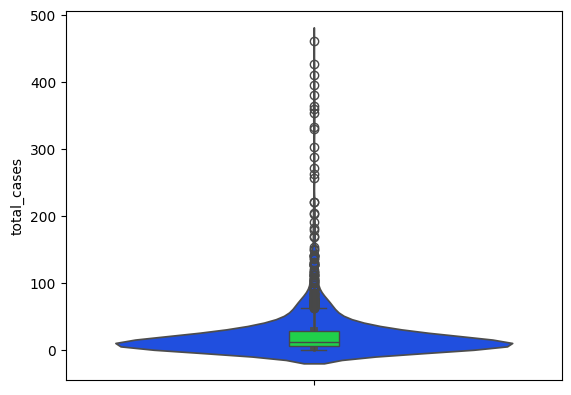

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt
#Se ajusta un estilo para todos los gráficos y mantener la uniformidad
plt.style.use('seaborn-v0_8-bright')
#Se plotea un gráfico de violín y, sobre él, un boxplot
sns.violinplot(train['total_cases'])
sns.boxplot(train['total_cases'], width = 0.1)
plt.show()
#Ref: https://seaborn.pydata.org/generated/seaborn.violinplot.html

Se puede observar mediante la gráfica de violín y de caja juntas, que:
- total_cases tiene muchos outliers
- A pesar de los outliers, es una variable con una distribución bastante "normal", aunque sesgada hacia valores entre cero y 50 aproximadamente con una cola ascendente.

Comprobemos la cantidad de ouliers que existen:

In [18]:
Q1, Q2, Q3 = train['total_cases'].quantile([0.25, 0.5, 0.75])
IQR = Q3 - Q1
lim_sup = Q3 + 1.5 * IQR
len(train['total_cases'][train['total_cases'] > lim_sup])

122

Aunque parecen muchos, 122 no es una cantidad sufiente como para desarrollar un modelo exclusivamente para estos, lo cual sería una posibilidad. Este modelo tendría una pobre capacidad predictora, por lo que se van a quedar tal cual para que los algoritmos de ML busquen los patrones o causas por los cuales se obtienen estos valores tan altos.

### Análisis bivariable

Ahora, se va a realizar un scatterplot para ver las posibles relaciones entre el número de casos y el resto de variables. Como tenemos 28 variables incluyendo la objetivo y el Cluster, se van a hacer 12 comparaciones: total_cases vs Resto de variables menos la variable Cluster.

Esto se realiza de esta manera porque la variable Cluster se va a usar como método de visualización añadido con el color. Es decir, para cada gráfica, se va a ver cada cluster de un color.

Esto también nos ayudará a entender por qué se han formado los clusters de la manera que lo ha hecho.

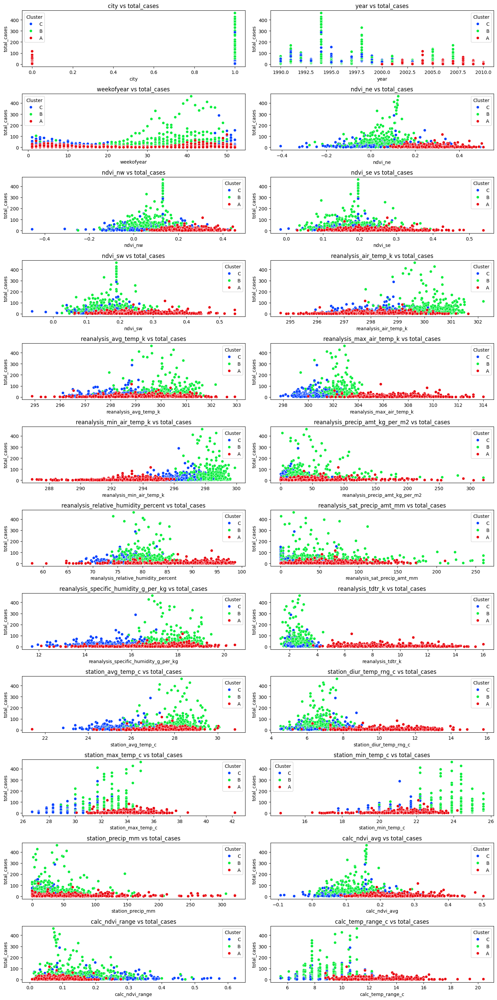

In [19]:
fig, axs = plt.subplots(12, 2, figsize = (15, 30))
for i, column in enumerate(train.columns):
    row = i//2
    col = i % 2
    #Se verifica que no se exceda las 12 * 2 = 24 subgráficas
    if row < 12:
        sns.scatterplot(x = column, y = 'total_cases', hue = 'Cluster', data = train, ax=axs[row, col])
        axs[row, col].set_title(f'{column} vs total_cases')
plt.tight_layout()
plt.show()

Veamos también una serie temporal de la cantidad total de casos por año

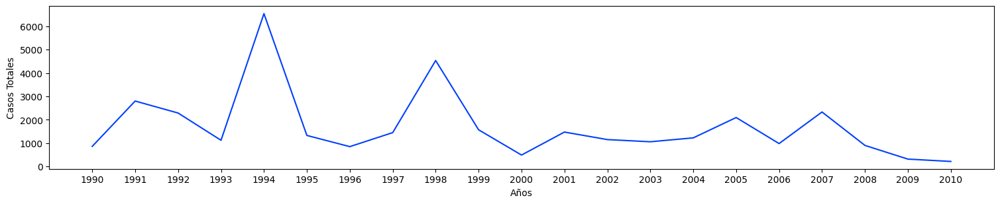

In [20]:
fig, ax = plt.subplots(figsize = (15, 3))
agg = train.groupby("year")["total_cases"].sum()
plt.plot(agg)
plt.xticks(agg.index)
plt.tight_layout()
plt.xlabel("Años")
plt.ylabel("Casos Totales")
plt.show()

Se sacan las siguientes observaciones:
- Claramente el cluster B da una información muy buena sobre aquellas instancias cuyos casos son muy elevados. Ojo, **todos los casos elevados pertenecen al Cluster B, pero no todos los que pertenecen al Cluster B son casos elevados**. Sin embargo, no hay demasiada distinción entre los clústeres A y C en todas las variables.
- Para algunas variables como `reanalysis_tdtr_k` sí que se ve una clara distinción entre los clústeres A y C: cuanto mayor es el valor de esta variable, más se acerca a la agrupación del cluster C y menos al A y viceversa. Sin embargo, para esta misma variable, valores muy bajos de esta se agrupa en el B a la vez que aumentan los casos afectados. Recordemos que esta variable describe el rango de temperatura diurna. Así que, cuando el rango es muy pequeño, los casos aumentan.
- La mayoría de casos elevados se encuentran en la ciudad "1".
- No se ve una clara relación lineal entre el número de casos y el año, pero los número de casos mayores se dieron entre 1993 y 1999.
- Aumentan los casos entre las semanas 35 y la 52
- Cuando los valores de ndvi están entre 0.1 y 0.2 (en general), aumentan los casos.
- En cuanto a las temperaturas, los mayores casos se dan cuando las temperaturas medias aumentan. Sin embargo, curiosamente, disminuyen cuando las máximas temperaturas disminuyen y las mínimas aumentan. Esto está muy en concordancia con la observación que se explicó antes del rango de temperaturas diurna.
- Las precipitaciónes abundantes decrementan el número de casos.
- Existe una gran diferencia en el número de casos y picos antes del año 2000 que en adelante.

En general, se observan claros patrones con la ayuda de la clusterización, que ha resultado ser muy útil.

Ahora, se volverá a utilizar la técnica del heatmap, pero esta vez solo nos centraremos en las relaciones entre las variables y la variable objetivo. Por lo tanto, en esta ocasión, cuanto mayor correlación exista, mejor capacidad predictora tendrá dicha variable, sobre todo para algoritmos basados en regresiones lineales.

Para poder realizar correctamente la matriz de correlaciones, se realiza el OneHotEncoding de la variable Cluster. La razón por la que se hace este cambio es porque realmente la variable Cluster no es ordinal, es decir, no es mayor, ni "mejor", el cluster "C" que el "A". Son atributos nominales. Por lo tanto, se crea una columna dicotómica para cada posible resultado.

In [21]:
train = pd.get_dummies(train, columns = ['Cluster'])

Se observa que el resultado son tres columnas adicionales con los Clústeres A, B y C y valores 1 y 0 (True y False).

In [22]:
train.head()

,city,year,weekofyear,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm,calc_ndvi_avg,calc_ndvi_range,calc_temp_range_c,calc_total_avg_air_temp,calc_avg_precip,total_cases,Cluster_A,Cluster_B,Cluster_C
0,1,1990,18,0.122600,0.103725,0.198483,0.177617,297.572857,297.742857,299.8,295.9,32.00,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0,0.150606,0.094758,9.4,24.932857,24.00,4,False,False,True
1,1,1990,19,0.169900,0.142175,0.162357,0.155486,298.211429,298.442857,300.9,296.4,17.94,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6,0.157479,0.027725,9.5,25.887857,13.27,5,False,False,True
2,1,1990,20,0.032250,0.172967,0.157200,0.170843,298.781429,298.878571,300.5,297.3,26.10,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4,0.133315,0.140717,9.4,26.172857,33.75,4,False,True,False
3,1,1990,21,0.128633,0.245067,0.227557,0.235886,298.987143,299.228571,301.4,297.0,13.90,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0,0.209286,0.116433,10.0,26.654286,8.95,3,False,True,False
4,1,1990,22,0.196200,0.262200,0.251200,0.247340,299.518571,299.664286,301.9,297.5,12.20,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8,0.239235,0.066000,11.1,27.655714,9.00,6,False,True,False


Para poder plotear el HeatMap, se necesita el dataset en formato "largo" o "Tidydata"

(array([ 0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5, 10.5,
        11.5, 12.5, 13.5, 14.5, 15.5, 16.5, 17.5, 18.5, 19.5, 20.5, 21.5,
        22.5, 23.5, 24.5, 25.5, 26.5, 27.5, 28.5, 29.5]),
 [Text(0, 0.5, 'city'),
  Text(0, 1.5, 'year'),
  Text(0, 2.5, 'weekofyear'),
  Text(0, 3.5, 'ndvi_ne'),
  Text(0, 4.5, 'ndvi_nw'),
  Text(0, 5.5, 'ndvi_se'),
  Text(0, 6.5, 'ndvi_sw'),
  Text(0, 7.5, 'reanalysis_air_temp_k'),
  Text(0, 8.5, 'reanalysis_avg_temp_k'),
  Text(0, 9.5, 'reanalysis_max_air_temp_k'),
  Text(0, 10.5, 'reanalysis_min_air_temp_k'),
  Text(0, 11.5, 'reanalysis_precip_amt_kg_per_m2'),
  Text(0, 12.5, 'reanalysis_relative_humidity_percent'),
  Text(0, 13.5, 'reanalysis_sat_precip_amt_mm'),
  Text(0, 14.5, 'reanalysis_specific_humidity_g_per_kg'),
  Text(0, 15.5, 'reanalysis_tdtr_k'),
  Text(0, 16.5, 'station_avg_temp_c'),
  Text(0, 17.5, 'station_diur_temp_rng_c'),
  Text(0, 18.5, 'station_max_temp_c'),
  Text(0, 19.5, 'station_min_temp_c'),
  Text(0, 20.5, 'sta

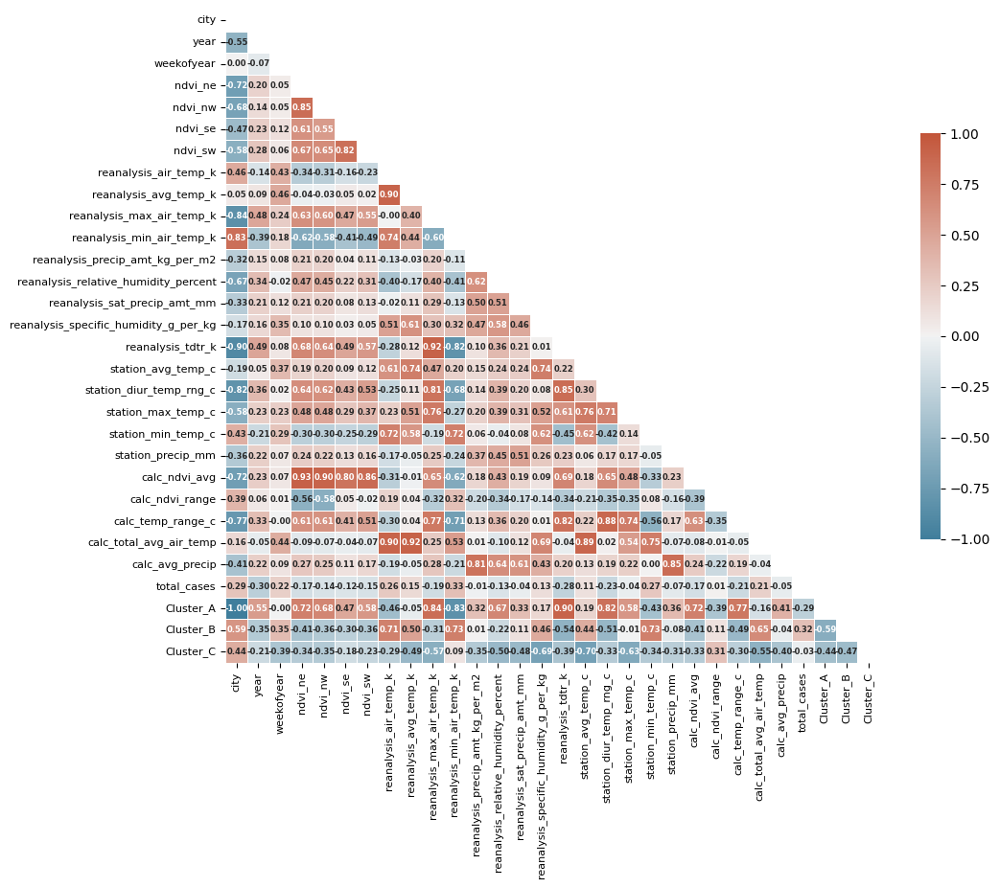

In [23]:

#Se calcula la matriz de correlación y se transforma en forma larga
corr = train.corr()
labels = train.columns.tolist()

#Se genera una máscara por el triángulo superior
mask = np.triu(np.ones_like(corr, dtype=bool))

#Se establece la figura de matplotlib
f, ax = plt.subplots(figsize=(11, 11))

#Se genera un mapa de color divergente
cmap = sns.diverging_palette(230, 20, as_cmap=True)

#Se plotea el mapa de calor con la máscara y un ratio correcto
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, vmin = -1, center=0,
            xticklabels = labels, yticklabels = labels,
            square=True, linewidths=.5, cbar_kws={"shrink": .5},
            annot = True, fmt=".2f", annot_kws = {"size": 6, "fontweight": 'bold'})
plt.xticks(fontsize = 8)
plt.yticks(fontsize = 8)

#Código adaptado de https://seaborn.pydata.org/examples/many_pairwise_correlations.html

Observando la matriz de correlaciones, se observa que no existe ninguna variable que esté fuertemente correlacionada con `total_cases`, teniendo el mayor coef. de Pearson `reanalysis_min_air_temp_k` con 0.33 (un nivel bajo). 

Sin embargo, se ha detectado una correlación absoluta entre el `Cluster_B`y `city`, con un coef. de Pearson igual a 1. Esto significa que podemos prescindir de una de las dos variables.

Por lo tanto, se va a prescindir de la variable del cluster B ya que, aunque a modo visualización ha sido de lo más útil para obtener ciertas conclusiones, a los algoritmos puede que los entorpezca por su absoluta correlación con la ciudad.

In [24]:
train.drop('Cluster_B', axis = 1, inplace = True)

Con esto finaliza la ingeniería de características de esta segunda actividad

---
# Predicción
---

## División de los conjuntos de *entrenamiento* y *validación*

Con el fin de testear adecuadamente los diferentes modelos a seleccionar, lo primero es dividir el dataset de entrenamiento en dos subdatasets:
- `train`: que no confunda el nombre, no es exactamente el mismo que el utilizado hasta el momento. Este es un subconjunto del total de entrenamiento que va a servir para entrenar y probar los distintos algoritmos y luego, poder comprobar la eficacia de cada uno de ellos.
- `validation`: este es un subconjunto del total del entrenamiento. Este subconjunto entra en el entrenamiento, sino que es el que se usa como testeo para comprobar la eficacia de los modelos. 

A su vez, cada uno de ellos se divide en X e y, donde X son las variables independientes (o entrenables) e "y" es la variable dependiente (u objetivo). Por lo tanto, de lo que se trata es de que los diferentes modelos a usar sean capaz de aprender lo mejor posible las relaciones y patrones ocultos existentes entre las instancias de "X" y el valor de "y". Esto es el cometido principal de los modelos **discriminantes**.

Sin embargo, aún se puede llevar esta metodología un poco más allá: en lugar de hacer una sola división para usar una parte para entrenar y otra para validar, ¿Qué tal si todo el dataset es, por partes, conjunto de entrenamiento y validación? Es decir, se puede entrenar el modelo varias veces utilizando diferentes partes para entrenar y el resto para validar y la evaluación será la media del **mae** de todos estos entrenamientos y validaciones.

En otras palabras, se utilizará la validación cruzada. Por lo tanto, tan solo se dividen los datos en X e y, ya que todos el dataset actuará como entrenamiento y validación.

De esta manera, además, se controlará el overfitting haciendo que el modelo a construir sea más rebusto, sea cual sea el algoritmo que se use.

In [25]:
X = train.drop('total_cases', axis = 1)
y = train['total_cases']

## Exploración de modelos

### Intro

Para la selección a modelos a probar se debe tener en cuenta el problema al que nos enfrentamos.

En primer lugar, se trata de un problema de **entrenamiento supervisado**, es decir, donde se tiene la etiqueta a predecir durante el entrenamiento (al contrario que ocurría con clustering a ciegas).

En segundo lugar, se trata de un problema de regresión. La variable a predecir es de tipo numérica discreta. Aunque las regresiones están pensadas para variables continuas, en este caso, donde la naturaleza de la variable hace que la cantidad de "tipos" discretos sea muy elevada, cobra más sentido tratarla como una variable continua donde, al final, se redondee a un número entero para obtener un número entero y discreto.

Por lo tanto, los modelos que se van a probar serán los siguientes:
- Regresión de Bosque Aleatorio (Random Forest): con este modelo se creará un conjunto de múltiples árboles de decisiones que se entrenan con diferentes subconjuntos de datos. Promedia las predicciones de todos los árboles para mejorar la precisión y reducir el sobreajuste.
- Máquinas de Soporte Vectorial (SVR - Support Vector Regression): extensión de SVM (Support Vector Machine) que se utiliza para la regresión. Se intenta encontrar una función que tenga el menor error dentro de un margen especificado.
- K-Vecinos más Cercanos (KNN - K-Nearest Neighbors): con este método se predice el valor de una nueva instancia basándose en los valores de sus k vecinos más cercanos en el espacio de características. La predicción se realiza tomando el promedio de los valores de los vecinos.
- Regresión por Proceso Gaussiano (Gaussian Process Regression): un enfoque bayesiano que trata la regresión como un problema de inferencia estadística. Utiliza funciones gaussianas para modelar la relación entre las variables, permitiendo capturar incertidumbres en las predicciones.
- XGBRegressor: este modelo, basado en el algoritmo de gradient boosting de XGBoost, entrena una serie de árboles de decisión secuenciales, donde cada nuevo árbol intenta corregir los errores de los anteriores. Es conocido por su eficiencia y capacidad de ajuste fino, mejorando precisión y rendimiento en problemas de regresión.

- LGBMRegressor: el modelo de LightGBM usa un enfoque de boosting basado en histogramas, que permite un entrenamiento rápido y eficiente en grandes conjuntos de datos. Al construir árboles de manera selectiva, LightGBM logra precisión en la predicción y es menos propenso a sobreajuste en comparación con otros métodos de boosting.

- CatBoostRegressor: CatBoost utiliza técnicas avanzadas de gradient boosting y es especialmente eficaz para datos categóricos. Construye árboles de decisión de forma iterativa y es conocido por su facilidad de uso y menor necesidad de preprocesamiento, ofreciendo gran precisión sin requerir un extenso ajuste de hiperparámetros.

Explicado esto, es importante aclarar lo siguiente. Aunque todos van a trabajar con el mismo `X_train`y se van a evaluar bajo la mísma función de pérdida, el  *Mean Absolute Error (MAE)*, algunos de ellos necesitan de una estandarización de los datos para que funcionen adecuadamente. Estos son aquellos basados en el cálculo de distancias: *SVR, KNeighborsRegressor* y *GaussianProcessRegressor*. Sin embargo, el mecanismo de *RandomForestRegressor* y del resto, no se ven afectado por el escalado, ya que tienen un sistema de "corte" entre los valores de las características, por ejemplo, en el diseño de sus árboles de decisión.

Por lo tanto, primero se va a trabajar con `X_train` sin escalar para el modelo de *RandomForestRegressor* y, a continuación, se usará el conjunto de entrenamiento escalado para el resto.

Con respecto a la elección de los hiperparámetros, la estrategia será la siguiente:
1. Se realizará una primera prueba para los distintos modelos con unos hiperparámetros estándar, ya sea porque son los que vienen por defecto al importar el modelo o porque son los recomendados según la literatura.
2. Se escogerán los mejores modelos para continuar con el estudio y se hará un *RandomSearchCV* para explorar estocásticamente un conjunto de hiperparámetros.
3. Basado en los resultados anteriores, se tratará de afinar los hiperparámetros con un ***Algoritmo Genético***.

## Preparación de funciones para transformaciones y métricas

Se va a crear otro pipeline exclusivo para procesar el dataset de test. Esto es importante ya que los modelos de ML se diseñarán en función del dataset de entrenamiento con todos sus preprocesos. Por lo tanto, para que el modelo de test pueda ser predicho correctamente, necesita tener un procesado que devuelva un dataset con una forma similar al de entrenamiento. 

Sin embargo, no vale la misma función de pipe usada para entrenamiento (y por eso se crea uno distinto al que ya existe), ya que la lógica es algo diferente: se van a usar modelos de escalado, clusterización, rellenado de nulos, etc, basados en el dataset de entrenamiento.

In [26]:
def run_pipeline_test(test, cols_with_mean, cols_with_median, linear_model, min_max_scaler, gmm):
    test = drop_columns(test)
    test = encode_labels(test)
    '''
    A diferencia del dataset de train, al test no se le puede aplicar la función "remove_high_na" ya que nunca se sabe
    cómo va a venir un dataset y, este modelo, debe ser capaz de sacar una predicción incluso para ina instancia 
    completamente vacía. Esto es capaz de hacerlo porque inputaría a cada columna su media, su mediana o su valor
    según el modelo de regresión lineal definido en con train según proceda.
    '''
    test = fill_nulls_test(test, cols_with_mean, cols_with_median, linear_model)
    test = treat_outliers(test)
    test = create_new_features(test)
    #Se escala utilizando el escalador ajustado con los datos de train
    test_norm = scale(test, min_max_scaler)
    #Se clusteriza con el modelo gmm creado con los datos de train
    clustering = cluster(test_norm, gmm)
    #Se incluye el clustering como una característica más
    test['Cluster'] = clustering
    '''
    Con el fin de realizar un OneHotEncoder más entendible, se van a sustituir los valores 
    númericos ordenados por letras, digamos, A, B y C, que representarán los tres clusteres.
    '''
    test['Cluster'].replace({0: "A", 1: "B", 2: "C"}, inplace = True)
    '''
    Como el análisis de características ya se ha hecho con train, ya se sabe que se necesita
    realizar el OneHotEncoder y luego eliminar el Cluster_B por estar correlacionado con city
    '''
    test = pd.get_dummies(test, columns = ['Cluster'])
    test.drop("Cluster_B", axis = 1, inplace = True)
    #Se devuelve el dataset procesado para poder predecir su variable target con algoritmos de ML
    return test

# Ejecutar el pipeline
test_processed = run_pipeline_test(test.copy(), cols_with_mean, cols_with_median, linear_model, min_max_scaler, gmm)

Ahora se importan todos los módulos necesarios de los modelos descritos

In [27]:
#Se importan los modelos así como los buscadores de hiperparámetros
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.metrics import mean_absolute_error, make_scorer
from sklearn.model_selection import cross_val_score
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

Se crea un diccionario con los resultados para luego crear una tabla comparativa

In [28]:
summary = {'Indice': [],
           'Modelo': [],
           'MAE test (DrivenData)': [],
           'MAE CV': [],
           'MAE CV std': [],
           'Algoritmo': [],
           'Hiperparámetros': [],
           'Características': [],
           'Descripción': []            
           }

Se crea una función para escribir en el resumen

In [29]:
def write_summary(cv_mae, cv_mae_std, model, features, description):
    global summary
    if len(summary['Indice']) == 0:
        index = 0
    else:
        index = max(summary['Indice']) + 1
    summary['Indice'].append(index)
    summary['Modelo'].append(f'{model.__class__.__name__[:5]}_{index}')
    summary['MAE test (DrivenData)'].append(None)
    summary['MAE CV'].append(cv_mae) #Resultado de la media de los resultados de "crossvalidation"
    summary['MAE CV std'].append(cv_mae_std) #Desviación estándar de los resultados del "crossvalidation"
    summary['Algoritmo'].append(model.__class__.__name__)
    summary['Hiperparámetros'].append(model.get_params())
    summary['Características'].append(features)
    summary['Descripción'].append(description)
    

Ahora, para probar de forma iterativa cada modelo, estos se van a almacenar en un diccionario con su forma de *Clase*.

In [30]:
dict_models = {
    'RandomForestRegressor': RandomForestRegressor,
    'SVR': SVR,
    'KNeighborsRegressor': KNeighborsRegressor,
    'GaussianProcessRegressor': GaussianProcessRegressor,
    'XGBRegressor': XGBRegressor,
    'LGBMRegressor': LGBMRegressor,
    'CatBoostRegressor': CatBoostRegressor
}

Como el escalador utilizado hasta el momento no contenía ni las varibales ´Cluster_A´, ´Cluster_C´ ni las etiquetas `total_cases`, se creará otro escalador basado en "X" e "y". De esta manera, se usarán escaladores con todos los datos posibles de entrenamiento real.

En caso de obtener valores más altos de los vistos en el entrenamiento, simplemente saldrán valores ligeramente superiores a 1. Es decir, si el valor más alto en el entrenamiento son 50 casos que corresponde a 1 y en test existen 100 casos, este obtendrá un valor de 2, que seguirá estando en una escala semejante como para predecir adecuadamente.

In [31]:
x_min_max_scaler = MinMaxScaler()
x_min_max_scaler.fit(X)
y_min_max_scaler = MinMaxScaler()
y_min_max_scaler.fit(np.array(y).reshape(-1, 1))

MinMaxScaler()

La función `cross_val_score` evalúa de forma interna el *mae* si se le indica en uno de sus argumentos. El problema es que, a la hora de hacer predicciones, puede que estos den algunos resultados negativos por tratarse de regresiones, haciendo que el mae se vea afectado por estos. Como la variable objetivo trata sobre personas afectadas, siempre será un número entero y natural, por lo que se creará una función personalizada de *score* que evalúe el *mae* pero convirtiendo antes las predicciones negativas a cero.

Podría pensarse que es buena idea, aprovechando la función, transformar también las variables a enteros, pero no se hará debido a que a veces tendrá que evaluar las predicciones escaladas entre 0 y 1, dependiendo del modelo.

In [32]:
def non_negative_mae(y_true, y_pred):
    y_pred = np.maximum(y_pred, 0)  # Reemplaza valores negativos por cero
    return mean_absolute_error(y_true, y_pred)

#Se crea un scorer con la función personalizada
scorer = make_scorer(non_negative_mae, greater_is_better=False)

Ahora, se crea una función personal para realizar la validación cruzada. De esta manera, se simplifica el resto del código llamando a una función con menos argumentos ya que la mayoría se mantienen. Además, se devolverá como resultado de la función no solo la media de los resultados de la validación cruzada, sino también su desviación estandar (*std*) para hacernos una idea de la precisión del conjunto de resultados.

In [33]:
def pers_cross_val_score(model, X, y, scaled = False):
    #Se crean 10 pliegues
    cv_mae_array = abs(cross_val_score(model, X, y, cv=5, scoring=scorer))
    cv_mae = cv_mae_array.mean()
    cv_mae_std = cv_mae_array.std()
    #Si X e y se han pasado escalados, el mae se tiene que desescalar para poder ser comparados
    if scaled == True:
        global y_min_max_scaler
        cv_mae = y_min_max_scaler.inverse_transform(cv_mae.reshape(-1, 1))[0][0]
        cv_mae_std = y_min_max_scaler.inverse_transform(cv_mae_std.reshape(-1, 1))[0][0]
    return cv_mae, cv_mae_std

Ahora, se creará una lista con el nombre de los modelos que sí requieren (o se aconseja) escalado y de aquellos que requieren fijar la semilla aleatoria para garantizar la reproducibilidad de los experimentos.

In [34]:
models_to_scale = ['SVR','KNeighborsRegressor','GaussianProcessRegressor'] 
models_to_seed = ['RandomForestRegressor', 'XGBRegressor', 'LGBMRegressor', 'CatBoostRegressor']

La siguiente función va a recibir los diferentes modelos, con las diferentes columnas del dataset que se van a ir escogiendo para hacer pruebas, así como los parámetros que se van a utilizar en el modelo. La misión de la función *try_models* será la de evaluar cada uno de estos modelos, ya sea con columnas y parámetros enviados en el argumento como de los modelos en su estado más básico por defecto.

Dentro de la lógica de la función, se ha creado un flujo para evaluar los modelos normalizados o no, y con semilla aleatoria o no, en función de las listas definidas anteriormente.

Además, llamará a la función que escribe en el resumen, de forma que finalmente se tengan todos los experimentos recogidos en una misma tabla.

In [92]:
def try_models(X, y, dict_models, dict_cols_selected = None, dict_params = None):
    for name, class_model in dict_models.items():
        #Se llaman a las variables de entorno globales
        global x_min_max_scaler
        global y_min_max_scaler
        global models_to_scale
        global models_to_seed

        #Se extraen las columnas en caso de haber sido pasadas. Sino, se escogen todas (esto se hace para unificar código más adelante)
        if dict_cols_selected == None:
            cols_selected = X.columns.tolist()
        else:
            cols_selected = dict_cols_selected[name].copy()
        #Se crea la instancia de la clase de modelo
        if dict_params == None:
            if name in models_to_seed:
                if name != 'CatBoostRegressor':
                    model = class_model(random_state = seed)
                else:
                    model = class_model(random_seed = seed)
            else:
                model = class_model()
        else:
            params = dict_params[name]
            model = class_model(**params)
        
        #Se envía una un dataset escalado a evaluar o no en función del tipo de modelo
        if name not in models_to_scale:
            # Realizar validación cruzada de 5-folds
            cv_mae, cv_mae_std = pers_cross_val_score(model, X.loc[:,cols_selected], y)    
        else:
            #Se normaliza X e y, luego se pasa a dataframe X para poder ser filtrado y enviado a evaluar
            X_norm = pd.DataFrame(x_min_max_scaler.transform(X), columns = X.columns)
            y_norm = y_min_max_scaler.transform(np.array(y).reshape(-1, 1))
            # Realizar validación cruzada de 5-folds
            cv_mae, cv_mae_std = pers_cross_val_score(model, X_norm.loc[:,cols_selected], y_norm, scaled = True) 

        #Se añaden los datos al resumen de modelos
        base_description = """Transformaciones: 
        - Eliminación de columnas ['week_start_date','precipitation_amt_mm', 'reanalysis_dew_point_temp_k']
        - Codificación de city en 0 y 1
        - Eliminación de instancias de más de un 50% de nulos en sus características
        - Relleno de nulos por la mediana o media según si tiene o no sesgo la característica y si tiene menos del 10% de nulos.
        - Relleno de nulos mediante regresión lineal para la característica ndvi_ne por tener más de un 10% de nulos.
        - Tratamiento de outliers sustituyéndolos por valores límites superiores (calculados en actividad 1).
        - Creación de nuevas características: ['calc_ndvi_avg', 'calc_ndvi_range', 'calc_temp_range_c', 'calc_total_avg_air_temp', 'calc_avg_precip']
        - Escalado entre 0 y 1 para clusterización
        - Clusterización en 3 clústeres mediante Gaussian Mixture Model
        - Eliminación del cluster "B" por correlación absoluta con la variable city
        """
        if name not in models_to_scale:
            description = base_description
        else:
            description = base_description + "\n- Escalado entre 0 y 1 para entrenamiento."
        print(f'MAE CV para {name}: {cv_mae}')
        write_summary(cv_mae, cv_mae_std, model, cols_selected, description)

## Primeros experimentos

Se prueban los modelos con los parámetros por defecto y con todas las columnas del dataset de entrenamiento

In [ ]:
try_models(X, y, dict_models)

MAE CV para RandomForestRegressor: 19.890978117169787
MAE CV para SVR: 33.194767105419714
MAE CV para KNeighborsRegressor: 21.418423577138768
MAE CV para GaussianProcessRegressor: 55.67719464482355
MAE CV para XGBRegressor: 22.3768203066653
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000973 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5144
[LightGBM] [Info] Number of data points in the train set: 1156, number of used features: 28
[LightGBM] [Info] Start training from score 17.960208
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000256 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5144
[LightGBM] [Info] Number of data points in the train set: 1157, number of used features: 28
[LightGBM] [Info] Start training from score 22.757995
[LightGBM] 

Ahora se van a graficar los resultados obtenidos del *crossvalidation* por modelo. 

Para ello, se crea un dataframe para *summary* y se define una función para plotear los resultados.

In [37]:
summary_df = pd.DataFrame(summary).drop('Indice', axis = 1)

Visualización de *summary*:

In [38]:
summary_df.head()

,Modelo,MAE test (DrivenData),MAE CV,MAE CV std,Algoritmo,Hiperparámetros,Características,Descripción
0,Rando_0,None,19.890978,9.413129,RandomForestRegressor,"{'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}","[city, year, weekofyear, ndvi_ne, ndvi_nw, ndvi_se, ndvi_sw, reanalysis_air_temp_k, reanalysis_avg_temp_k, reanalysis_max_air_temp_k, reanalysis_min_air_temp_k, reanalysis_precip_amt_kg_per_m2, reanalysis_relative_humidity_percent, reanalysis_sat_precip_amt_mm, reanalysis_specific_humidity_g_per_kg, reanalysis_tdtr_k, station_avg_temp_c, station_diur_temp_rng_c, station_max_temp_c, station_min_temp_c, station_precip_mm, calc_ndvi_avg, calc_ndvi_range, calc_temp_range_c, calc_total_avg_air_temp, calc_avg_precip, Cluster_A, Cluster_C]","Transformaciones: \n - Eliminación de columnas ['week_start_date','precipitation_amt_mm', 'reanalysis_dew_point_temp_k']\n - Codificación de city en 0 y 1\n - Eliminación de instancias de más de un 50% de nulos en sus características\n - Relleno de nulos por la mediana o media según si tiene o no sesgo la característica y si tiene menos del 10% de nulos.\n - Relleno de nulos mediante regresión lineal para la característica ndvi_ne por tener más de un 10% de nulos.\n - Tratamiento de outliers sustituyéndolos por valores límites superiores (calculados en actividad 1).\n - Creación de nuevas características: ['calc_ndvi_avg', 'calc_ndvi_range', 'calc_temp_range_c', 'calc_total_avg_air_temp', 'calc_avg_precip']\n - Escalado entre 0 y 1 para clusterización\n - Clusterización en 3 clústeres mediante Gaussian Mixture Model\n - Eliminación del cluster ""B"" por correlación absoluta con la variable city\n"
1,SVR_1,None,33.194767,6.462950,SVR,"{'C': 1.0, 'cache_size': 200, 'coef0': 0.0, 'degree': 3, 'epsilon': 0.1, 'gamma': 'scale', 'kernel': 'rbf', 'max_iter': -1, 'shrinking': True, 'tol': 0.001, 'verbose': False}","[city, year, weekofyear, ndvi_ne, ndvi_nw, ndvi_se, ndvi_sw, reanalysis_air_temp_k, reanalysis_avg_temp_k, reanalysis_max_air_temp_k, reanalysis_min_air_temp_k, reanalysis_precip_amt_kg_per_m2, reanalysis_relative_humidity_percent, reanalysis_sat_precip_amt_mm, reanalysis_specific_humidity_g_per_kg, reanalysis_tdtr_k, station_avg_temp_c, station_diur_temp_rng_c, station_max_temp_c, station_min_temp_c, station_precip_mm, calc_ndvi_avg, calc_ndvi_range, calc_temp_range_c, calc_total_avg_air_temp, calc_avg_precip, Cluster_A, Cluster_C]","Transformaciones: \n - Eliminación de columnas ['week_start_date','precipitation_amt_mm', 'reanalysis_dew_point_temp_k']\n - Codificación de city en 0 y 1\n - Eliminación de instancias de más de un 50% de nulos en sus características\n - Relleno de nulos por la mediana o media según si tiene o no sesgo la característica y si tiene menos del 10% de nulos.\n - Relleno de nulos mediante regresión lineal para la característica ndvi_ne por tener más de un 10% de nulos.\n - Tratamiento de outliers sustituyéndolos por valores límites superiores (calculados en actividad 1).\n - Creación de nuevas características: ['calc_ndvi_avg', 'calc_ndvi_range', 'calc_temp_range_c', 'calc_total_avg_air_temp', 'calc_avg_precip']\n - Escalado entre 0 y 1 para clusterización\n - Clusterización en 3 clústeres mediante Gaussian Mixture Model\n - Eliminación del cluster ""B"" por correlación absoluta con la variable city\n \n- Escalado entre 0 y 1 para entrenamiento."
2,KNeig_2,None,21.418424,11.206360,KNeighborsRegressor,"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}","[city, year, weekofyear, ndvi_ne, ndvi_nw, ndvi_se, ndvi_sw, reanalysis

Función para plotear (diagrama de barras horizontales con líneas de "error" para el *std*):

In [141]:
def plot_results(df, col, dataset = 'completo'):
    #Se crea la figura
    fig, ax = plt.subplots(figsize = (10, 5))

    #Se plotea la marca a mejorar
    sns.barplot(x = [28] * df.shape[0], y = 'Modelo', data = df, label = "Mejora base", color = 'b', alpha = 0.5)
    #Se plotean los resultados
    sns.barplot(x = col, y = 'Modelo', data = df, label = col, color = 'b')
    #Se plotean las desviaciones estándar de cada modelo
    for i, value in enumerate(df['MAE CV std']):
        col_value = df[col].iloc[i] #Valor de la columna (MAE CV, por ejemplo)
        start = df[col].iloc[i] - value/2
        end = df[col].iloc[i] + value/2
        if i == 0:
            plt.plot([start, end], [i, i], color = "red", label = "std")
        else:
            plt.plot([start, end], [i, i], color = "red")
        #Se añade texto para ver los resultados
        plt.text(x = 0.2, y = i, s = f'MAE CV = {round(col_value, 4)}, std = {round(value, 4)}', 
                 color = "white", fontweight = 'bold', size = 6)

    #Etiquetas y título
    ax.legend(ncol=3, loc="upper right", frameon=True)
    ax.set(ylabel="", xlabel=f"{col} por Modelo Experimentado")
    ax.set_title(f"Evaluación del Algoritmos mediante MAE CV dataset {dataset}")
    sns.despine(left=True, bottom=True)
    #Ref: https://seaborn.pydata.org/examples/part_whole_bars.html



Se plotean los resultados ordenándolos según el mejor MAE de validación (el más bajo)

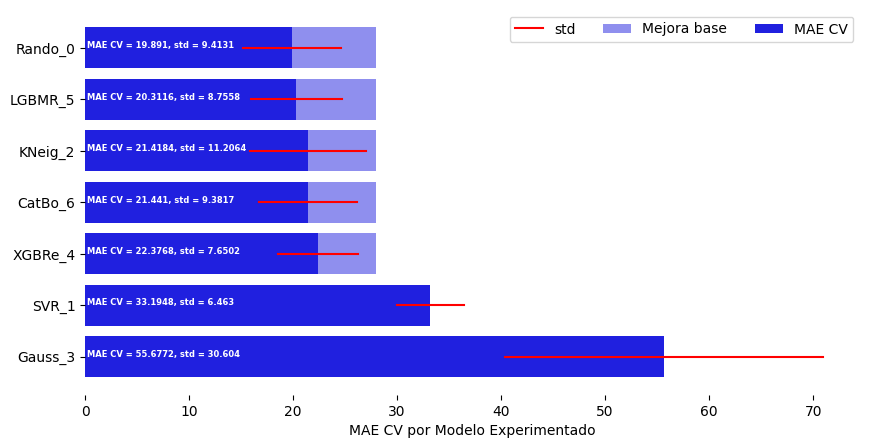

In [40]:
plot_results(summary_df.sort_values(by = 'MAE CV'), 'MAE CV')

Observaciones:
- `Rando_0`: tiene presenta el mejor valor *MAE* mediante *cv* obtenido. Ha obtenido mejor marca que la de partida seteada como objetivo de mejora (un MAE de 28). Sin embargo, la desviación estandar de su *cv* no es de la mejor. Cuanto menor sea el *std*, más robusta es la marca obtenida.
- `LGBMR_5`: tiene muy buena puntuación también, con un peor *mae* que el anterior pero un mejor *std*.
- `KNeig_2`: también mejora la marca base (*mae* = 28), pero es un poco peor que el anterior en *scoring* y *std*.
- `XGBRe_4`: Continúa en una buena línea junto con los anteriores, se sigue considerando para mejorar hiperparámetros.
- `CatBo_6`: Resultados muy parecidos al anterior con un *std* un poco mayor.
- `SVR_1`: no mejora la marca, pero eso no significa que no se puedan encontrar unos parámetros que sí la mejoren. Además, es el más estable con su marca, pues presenta la menor de las *std*.
- `Gauss_3` tiene una marca realmente mala, con muchísima diferencia con respecto al resto y una *std* muy grande. 

Se decide eliminar aquellos modelos que no hayan sido capaz de mejorar la marca *mae* = 28 del estudio y continuar con los otros, ya que, normalmente en las predicciones de test, se empeora.

In [41]:
models_to_remove = [model for model in dict_models.keys() if 
                    summary_df['MAE CV'][summary_df['Algoritmo'] == model].iloc[0] > 28]
for model in models_to_remove:
    del dict_models[model]

Se visualizan los modelos a buscar sus mejores hiperparámetros

In [42]:
list(dict_models.keys())

['RandomForestRegressor',
 'KNeighborsRegressor',
 'XGBRegressor',
 'LGBMRegressor',
 'CatBoostRegressor']

## Optimización de hiperparámetros: Algoritmo Genético

La siguiente función tiene una misión muy especial: **optimizar no solo los hiperparámetros de los modelos, sino también las características a usar del dataset con el fin de obtener la mejor puntuación posible.**

A diferencia de otros algoritmos estocásticos como *RandomizedSearchCV*, este tipo de algoritmo presenta una mejora direccionada gracias a su inteligente sistema basado en el propio funcionamiento de la evolución natural.

Además, tiene la ventaja de poder establecer fácilmente el método de penalización así como la estructura de sus indiviuos (es decir, la estructura genética), pudiendo añadir las características como un cromosoma más.

Hay infinitas formas de configurar al individuo y su estructura genética. En este caso, se ha escogido la siguiente estructura:

Individuo = {"Model": *class_model*, 
            "selected_params": {*selected_params*}, 
            "cols_selected": [*cols_selected*]}

Cada modelo se enviará por separado, es decir, la elección del modelo no será algo a optimizar.

Tanto los parámetros como las columnas serán seleccionadas para cada individuo de forma aleatoria. Sin embargo, en el caso de las columnas, se creará una distribución de probabilidad de forma que se favorezca la elección de una cantidad mayor de características, ya que, normalmente, cuantas más caraceterísticas se tengan, mejores resultados se obtienen.

La función fitness evaluará, al igual que anteriormente, según la media del *cv* del modelo con sus datos de entrenamiento ya sea tal cual o escalado.

Al final, se devolverá como resultados el mejor individuo con sus características genéticas, el mejor *mae cv*, su *std* y un histórico del *mae* promedio de la población.

Por lo demás, he intentado que el código esté comentado lo mejor posible para que sea autoexplicativo.

**IMPORTANTE**: He escogido la estructura de los apuntes de clase del *AG* y lo he adaptado al problema que ataña, por lo que los nombres de las funciones podrían coincidir.

In [ ]:
import random
np.random.seed(seed)
random.seed(seed)
def AG(class_model, params, N = 12, generations = 15):
    '''N representa el número de individuos por población, generations representa la cantidad de generaciones'''
    start_time = time.time()
    def generate_ind(class_model, params):
        '''Función para generar un individuo'''
        global X
        global y
        '''Función para generar a un individuo'''
        selected_params = {
            param: random.choice(values) for param, values in params.items()
        }
        model = class_model(**selected_params)
        '''
        Ahora, también se tendrá en cuenta las columnas de X con las que se va a entrenar
        el modelo como una variable más a optimizar. Por lo tanto, se escogerá aleatoriamente
        con una distribución de probabilidad dada (se prioriza un número alto de características)
        un número de columnas y luego, igualmente, se escogerán aleatoriamente dichas columnas
        con reemplazo para evitar que se escoja dos veces o más la misma.
        '''
        total_cols = len(X.columns.tolist())
        number_posible_cols = list(range(1, total_cols + 1))
        prob = np.linspace(1, 10, total_cols) #Se genera valores del 1 al 10 en tantos pasos como columnas haya
        prob /= prob.sum() #Se dividi cada valor entre la suma total para obtener valores entre 0 y 1, aumentando en cada paso
        n_cols_selected = np.random.choice(number_posible_cols, p = prob) #Más probable que escoge un número alto
        cols_selected = random.sample(X.columns.tolist(), k = n_cols_selected)
        #Ref: https://numpy.org/doc/stable/reference/random/generated/numpy.random.choice.html
        #      https://docs.python.org/es/3/library/random.html
        
        individual = {
            'model': model, #el modelo no es aleatorio, porque se va a optimizar cada modelo por separado
            'cols_selected': cols_selected, # Se codifican las columnas usadas como un gen porque se usará para mutar
            'selected_params': selected_params #Igual para los hiperparámetros
        }
        return individual
    def generate_pop(N, class_model, params):
        '''Se generan N individuos'''
        print(f"Generando Población Inicial de {N} individuos para la clase {class_model.__name__}...")
        return [generate_ind(class_model, params) for _ in range(N)]
    
    def fitness(individual):
        '''Función de evaluación'''
        global X
        global y
        global models_to_scale
        '''Se calcula el fitness. Como la función de coste es el mae, el target será 0'''
        model = individual['model']
        cols_selected = individual['cols_selected'].copy()
        #Si el class_model no esta en los modelos para escalar, no hay que desescalar entrenar y puntuar
        if model.__class__.__name__ not in models_to_scale:
            cv_mae, cv_mae_std = pers_cross_val_score(model, X.loc[:,cols_selected], y)
        else:
            #Se normaliza X e y, luego se pasa a dataframe X para poder ser filtrado y enviado a evaluar
            X_norm = pd.DataFrame(x_min_max_scaler.transform(X), columns = X.columns)
            y_norm = y_min_max_scaler.transform(np.array(y).reshape(-1, 1))
            cv_mae, cv_mae_std = pers_cross_val_score(model, X_norm.loc[:,cols_selected], y_norm, scaled = True)
        return cv_mae, cv_mae_std #Cuanto más ceranos a cero, mejor
    
    def calc_pop_fitness(pop):
        '''Se calcula el fitness para cada individuo'''
        pop_fitnesses = [(fitness(ind), ind) for ind in pop]
        #Se ordena de menor a mayor, ya que menor mae es mejor. En caso de empate, se ordena con el menor std
        pop_fitnesses = sorted(pop_fitnesses, key = lambda x: (x[0][0], x[0][1]))
        return pop_fitnesses

    def evolve(pop, class_model, params, mutate = 0.01, retain = 0.2, random_select = 0.05):
        '''Función de evolución: mutación y reproducción'''
        global X
        global y
        '''Función para seleccionar los mejores, mutar y reproducir'''
        #Se calcula el fitness para toda la población actual
        pop_fitnesses = calc_pop_fitness(pop)
        #Se extrae solo a los individuos, que ya están ordenados de mejor a peor
        pop_ordered = [x[1] for x in pop_fitnesses]
        #Se escoge al primer 20% de individuos (el 20% mejor) para ser los padres
        retain_length = int(len(pop) * retain)
        parents = pop_ordered[:retain_length]

        #Se añaden individuos aleatoriamente para promover la diversidad genética
        for individual in pop_ordered[retain_length:]:
            if random_select > np.random.rand():
                parents.append(individual)
        
        
        #Se mutan algunos
        for individual in parents:
            if mutate > np.random.rand():
                '''
                El tipo de individuo creado es bastante especial: tiene tres cromosomas, pero realmente 
                tan solo uno (model) es el que ha funcionado para generar el fitness, ya que este
                cromosoma ha sido entrenado con los otros dos que se han añadido como info adicional.
                Por lo tanto, al mutar, se podrán mezclar cromosomas de un individuo con los de otro pero,
                tras hacer esto, se deberá ejecutar de nuevo el modelo resultante con esta nueva
                combinación de cromosomas, es decir, con los parámetros resultantes y las columnas 
                escogidas.
                '''
                feature_to_mutate = random.choice(list(individual.keys()))
                if feature_to_mutate == 'cols_selected':
                    #La forma de mutar será eliminando columnas si hay, al menos, más de una
                    cols_selected = individual['cols_selected'].copy() #Se usa copy para desligar la variable de la dirección de memoria
                    if len(cols_selected) > 1:
                        cols_selected.pop(-1) #Se elimina la última col
                    individual['cols_selected'] = cols_selected
                else:
                    selected_params = {
                            param: random.choice(values) for param, values in params.items()
                                    }
                    individual['selected_params'] = selected_params
                    model = class_model(**selected_params)
                    individual['model'] = model
        #Reproducción
        #Se calcula la cantidad de hijos a tener (hasta completar la población)
        desired_children_length = len(pop) - len(parents)
        children = []
        #Se itera teniendo hijos hasta completar la población
        while len(children) < desired_children_length:
            # Se escoge, de entre los padres, un padre y una madre diferentes
            male, female = random.sample(parents, k = 2)
            # Para el padre, se escoge las columnas, para la madre, los parámetros
            cols_selected = male['cols_selected']
            selected_params = female['selected_params']
            #Se entrena de nuevo el modelo
            model = class_model(**selected_params)
            #Se crea el nuevo individuo hijo
            child = {
                'model': model,
                'cols_selected': cols_selected,
                'selected_params': selected_params
            }
            #Se añade a la lista de hijos
            children.append(child)
        #Se suma la lista de padres e hijos, formando una nueva población del mismo tamaño que la anterior
        new_pop = parents + children
        return new_pop

    def calc_avg_fitnesses(pop_fitnesses):
        '''Con esta función se calcula la media de los fitnesses como control de mejora'''
        sum_mae = 0
        sum_std = 0
        for mae_std, _ in pop_fitnesses:
            sum_mae += mae_std[0]
            sum_std += mae_std[1]
        avg_mae = sum_mae / len(pop_fitnesses)
        avg_std = sum_std / len(pop_fitnesses)
        return avg_mae, avg_std
    
    #Se ejecuta el Algoritmo Genético
    error = 12.0 #error aceptado del mae (se considera bueno teniendo en cuanta la experimentación previa)
    #Se crea una lista para el historial de la media de los fitness para luego ver su evolución
    hist_pop_fitnesses = []
    #Se inicializa el proceso
    pop = generate_pop(N, class_model, params)
    #Calculo el fitness para la población
    pop_fitnesses = calc_pop_fitness(pop)
    #Se calcula la media para el historial
    avg_mae, avg_std = calc_avg_fitnesses(pop_fitnesses)
    hist_pop_fitnesses.append(avg_mae)
    #El mejor individuo es el primero por orden en la población, ya que se devolvió ordenada
    print(f'Mae cv del Mejor modelo en la inicialización: {pop_fitnesses[0][0][0].round(4)} con std = {pop_fitnesses[0][0][1].round(4)}')

    print("Comienza la búsqueda...\n")
    for i in range(1, generations):
        pop = evolve(pop, class_model, params, retain=0.2, random_select=0.2, mutate=0.2)
        #Calculo el fitness para la población
        pop_fitnesses = calc_pop_fitness(pop)
        #Se calcula la media para el historial
        avg_mae, avg_std = calc_avg_fitnesses(pop_fitnesses)
        hist_pop_fitnesses.append((avg_mae, avg_std))
        #El mejor individuo es el primero por orden en la población, ya que se devolvió ordenada
        best_ind = pop_fitnesses[0][1]
        best_mae = pop_fitnesses[0][0][0].round(4)
        best_mae_std = pop_fitnesses[0][0][1].round(4)
        print(f'avg_Mae_val de la población en la generación {i}: {avg_mae} con std media = {avg_std}')
        print(f'Mae_val del Mejor modelo en la generación {i}: {best_mae} con std = {best_mae_std}')

        if best_mae < error:
            break
    print(f"Mejor Mae_val de la clase {class_model.__name__}: {best_mae} con std = {best_mae_std}")
    end_time = time.time()
    total_time = round((end_time - start_time) / 3600, 2) #Cálculo de tiempo de procesamiento en horas
    print(f"\n\nTiempo total de búsqueda con AG: {total_time} h")
    return best_ind, best_mae, best_mae_std, hist_pop_fitnesses




Ahora, para optimizar cada modelo por separado, se creará un diccionario que contendrá, como clave, el nombre de cada modelo y como valores diccionarios con un espacio de búsqueda de parámetros a combinar.

In [44]:
dict_params_to_optimize = {
    'RandomForestRegressor': {
        'criterion': ['squared_error', 'absolute_error'],
        'n_estimators': [100, 200, 300, 400, 500],  # Número de árboles en el bosque
        'max_features': [None, 'sqrt', 'log2'],  # Número de características a considerar para la mejor división
        'max_depth': [None, 10, 20, 30],  # Profundidad máxima del árbol
        'min_samples_split': [2, 5, 10],  # Número mínimo de muestras requeridas para dividir un nodo
        'min_samples_leaf': [1, 2, 4],  # Número mínimo de muestras requeridas para estar en un nodo hoja
        'bootstrap': [True, False],  # Si se utiliza el muestreo bootstrap
        'random_state': [seed]  # Para la reproducibilidad
    },
    'SVR': {
        'C': [0.1, 1, 10, 100, 1000],           # Coeficiente de penalización del error
        'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],  # Tipo de kernel
        'gamma': ['scale', 'auto', 0.01, 0.1, 1],  # Coeficiente del kernel para 'rbf', 'poly' y 'sigmoid'
        'degree': [2, 3, 4],                    # Grado del polinomio (solo se usa en el kernel 'poly')
        'epsilon': [0.1, 0.2, 0.5, 0.3, 0.01]   # Margen de tolerancia para no penalizar errores pequeños
    },
    'KNeighborsRegressor': {
        'n_neighbors': [3, 5, 10, 15, 20],             # Número de vecinos
        'weights': ['uniform', 'distance'],            # Tipo de ponderación de los vecinos
        'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],  # Algoritmo utilizado para encontrar vecinos
        'leaf_size': [10, 30, 50, 70],                 # Tamaño de las hojas para 'ball_tree' o 'kd_tree'
    },
   'XGBRegressor': {
        'n_estimators': [100, 200, 300],           # Número de árboles de decisión en el modelo de boosting
        'max_depth': [3, 5, 7],                    # Profundidad máxima de cada árbol, para controlar el ajuste del modelo
        'learning_rate': [0.01, 0.05, 0.1],        # Tasa de aprendizaje; valores más bajos pueden mejorar la precisión pero requieren más iteraciones
        'subsample': [0.7, 0.8, 0.9, 1.0],         # Porcentaje de muestras usadas para entrenar cada árbol, ayuda a evitar el sobreajuste
        'colsample_bytree': [0.6, 0.7, 0.8, 1.0],  # Porcentaje de características usadas en cada árbol, para controlar la diversidad del modelo
        'reg_alpha': [0, 0.1, 0.5, 1],             # Regularización L1, para reducir el sobreajuste aplicando penalización a pesos altos
        'reg_lambda': [0, 0.1, 0.5, 1],            # Regularización L2, también para evitar el sobreajuste mediante penalización a pesos altos
        'random_state': [seed]                     # Semilla aleatoria para garantizar la reproducibilidad del modelo
},
'LGBMRegressor': {
        'n_estimators': [100, 200, 300],           # Número de árboles en el modelo
        'max_depth': [-1, 5, 10, 15],              # Profundidad máxima de los árboles; -1 significa sin límite
        'learning_rate': [0.01, 0.05, 0.1, 0.2],   # Tasa de aprendizaje para ajustar la contribución de cada árbol
        'num_leaves': [20, 31, 40, 50],            # Número máximo de hojas por árbol; más hojas pueden aumentar la precisión pero también el riesgo de sobreajuste
        'min_child_samples': [10, 20, 30],         # Mínimo de muestras necesarias en una hoja para reducir el sobreajuste
        'subsample': [0.7, 0.8, 0.9, 1.0],         # Fracción de datos usados para entrenar cada árbol, ayuda a evitar el sobreajuste
        'colsample_bytree': [0.6, 0.8, 1.0],       # Proporción de características usadas en cada árbol, aumentando la diversidad del modelo
        'random_state': [seed]                     # Semilla para asegurar la reproducibilidad
},
'CatBoostRegressor': {
        'iterations': [100, 200, 300],             # Número de iteraciones de boosting (equivalente al número de árboles)
        'depth': [4, 6, 8, 10],                    # Profundidad de cada árbol, para controlar el ajuste del modelo
        'learning_rate': [0.01, 0.05, 0.1],        # Tasa de aprendizaje, controla el peso de cada nuevo árbol
        'l2_leaf_reg': [1, 3, 5, 7, 9],            # Regularización L2 aplicada a los pesos de las hojas para reducir el sobreajuste
        'bagging_temperature': [0.0, 0.5, 1.0],    # Controla el enfoque de muestreo por bagging; valores más altos generan árboles más diversos
        'random_seed': [seed]                      # Semilla aleatoria para asegurar la reproducibilidad del modelo
}
}
# Ref: Los valores escogidos de cada modelo provienen de Chatgpt habiendo sido modificados algunos parámetros por decisión personal 

A continuación, se itera llamando a cada modelo con sus posibles parámetros a combinar y enviándolos al algoritmo genético para buscar soluciones subóptimas.

In [45]:
#Se crea un dict donde se almacenará, por cada clase de modelo, una lista del mejor modelo del AG y su Mae_val
best_models_from_AG = {key: None for key in dict_models.keys()}
#Se itera en cada clase de modelo
for name, class_model in dict_models.items():
    #Se cogen los parámetros a optimizar definidos
    params = dict_params_to_optimize[name]
    #Se llama al Algoritmo Genético
    best_ind, best_mae, best_mae_std, hist_pop_fitnesses = AG(class_model, params)
    #Se añade el mejor individuo y mae_val al diccionario best_models_from_AG
    best_models_from_AG[name] = [best_ind, best_mae, best_mae_std, hist_pop_fitnesses]

Generando Población Inicial de 12 individuos para la clase RandomForestRegressor...
Mae cv del Mejor modelo en la inicialización: 19.0723 con std = 9.1433
Comienza la búsqueda...

avg_Mae_val de la población en la generación 1: 22.01507120727683 con std media = 10.736271280427802
Mae_val del Mejor modelo en la generación 1: 19.0723 con std = 9.1433
avg_Mae_val de la población en la generación 2: 20.866441409715755 con std media = 10.089022199267523
Mae_val del Mejor modelo en la generación 2: 19.1147 con std = 9.1447
avg_Mae_val de la población en la generación 3: 20.30211109767276 con std media = 9.583542179112545
Mae_val del Mejor modelo en la generación 3: 19.1147 con std = 9.1447
avg_Mae_val de la población en la generación 4: 19.875081552301666 con std media = 9.170757115102639
Mae_val del Mejor modelo en la generación 4: 19.0245 con std = 9.0578
avg_Mae_val de la población en la generación 5: 19.48175833868901 con std media = 9.14278451280001
Mae_val del Mejor modelo en la genera

Como se puede ver en el log, *RandomForestRegressor* se ha tomado 2.21 h en terminar el algoritmo a pesar de que solamente se ha configurado una población de 12 individuos y 15 generaciones (algo bajo para un AG con la cantidad de parámetros que se han enviado).

También, *CatBoostRegressor* se ha tomado 0.77 h. Bastante menos pero demasiado como para realizar más pruebas.

El resto, han tenido tiempos bastante más bajos. Esto es debido a varios factores:

- *RandomForestRegressor* internamente ya realiza una selección aleatoria de características (*RandomForest*) además del *Bagging*, por lo que, en teoría, no sería necesaria la propia variación de columnas. Además, también de forma interna promedia muchos árboles aleatorios *No débiles* (es decir, con más de un nivel y tan largos como se configure en su parámetro `max_depth`). Es decir, es un modelo muy pesado, a diferencia de, por ejemplo, *XGBRegresor* o *LGBMRegressor* que se basan en el algoritmo de *Boosting*, es decir, crea muchos árboles aleatorios *Débiles*, cuyo resultado final es la media de las predicciones de estos árboles débiles de tan solo un nivel de profundidad.
- Se está utilizando la validación cruzada en lugar de una validación simple de una división del dataset en subconjuntos de entrenamiento y validación. Es decir, cada modelo se evalúa tantas veces como pliegues se haya configurado (5 en este caso). Esto aumenta multiplicativamente el tiempo de entrenamiento y validación de cada modelo. Para los más pesados, es un problema computacional.
- Se está utilizando un dataset de 28 dimensiones. Se podría optar por reducir dimensionalidades mediante *PCA*, o algo más costoso y no lineal como *t-SNE* o incluso *autoencoders*. Sin embargo, todos estos métodos por buenos que sean siempre tienen una pérdida de información asociada. 

En caso de que se necesitase reducir la latencia del modelo, se estudiarían las posibilidades mencionadas de reducción de dimensionalidad, uso de algoritmos simples y veloces exclusivamente o métodos de validaciones no cruzados. 

Dicho lo cual, una vez se han obtenido los "mejores" (subóptimos) modelos con la ayuda del algoritmo genético, se muestran sus *mae cv*  para ver las puntuaciones:

In [46]:
for model_name, values in best_models_from_AG.items():
    print(f"Mejor modelo {model_name}\nMAE CV: {values[1]} con std = {values[2]}\n")

Mejor modelo RandomForestRegressor
MAE CV: 18.9738 con std = 9.2501

Mejor modelo KNeighborsRegressor
MAE CV: 19.8566 con std = 10.1503

Mejor modelo XGBRegressor
MAE CV: 18.5156 con std = 9.1159

Mejor modelo LGBMRegressor
MAE CV: 19.3493 con std = 8.8952

Mejor modelo CatBoostRegressor
MAE CV: 17.7789 con std = 9.1097



Se visualiza, además, el histórico de mejora de cada población completa para cada modelo

RandomForestRegressor
KNeighborsRegressor
XGBRegressor
LGBMRegressor
CatBoostRegressor


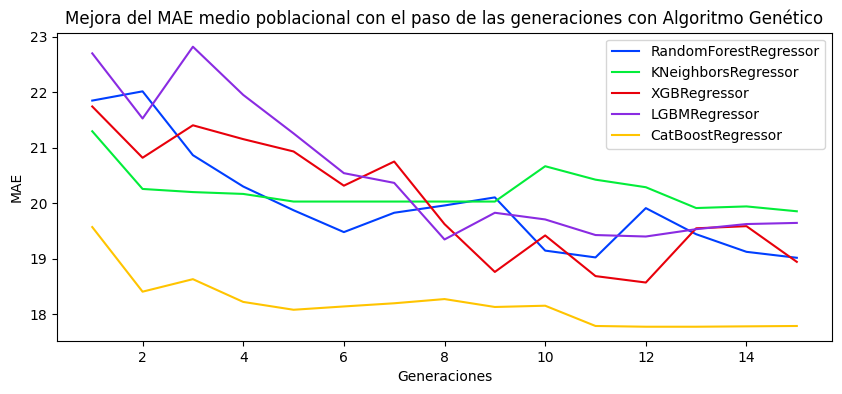

In [140]:
fig, ax = plt.subplots(figsize = (10, 4))
for model, values in best_models_from_AG.items():
    print(model)
    hist = values[3]
    mae_pop_hist = []
    for i, value in enumerate(hist):
        if i == 0: 
            mae_pop_hist.append(value)
        else:
            mae_pop_hist.append(value[0])
    sns.lineplot(x = list(range(1, len(mae_pop_hist)+1)), y = mae_pop_hist, label = model, ax = ax)

plt.xlim()
plt.xlabel("Generaciones")
plt.ylabel("MAE")
plt.title("Mejora del MAE medio poblacional con el paso de las generaciones con Algoritmo Genético")
plt.show()

Se observa claramente que, para cada modelo, al *AG* ha conseguido mejorar sus puntuaciones entre la primera y la décimoquinta generación (aunque no siempre se mejora de una generación para otra).

Se crea el diccionario de parámetros por modelo con los parámetros obtenidos por el AG. Además, se crea otro diccionario cuyas claves serán los nombres de las clases de modelo y sus valores serán las listas de las columnas usadas por cada modelo.

In [47]:
dict_cols_selected = {}
dict_params = {}
for name in dict_models.keys():
    #Se extrae el modelo y las columnas (los parámetros no hace falta, pues se saca del propio modelo)
    individual = best_models_from_AG[name][0] #Se extrae primero el individuo perteneciente a la cls de modelo
    selected_params = individual['selected_params'] #Se extrae el modelo del individuo
    cols_selected = individual['cols_selected'].copy() #Se extraen las columnas seleccionadas para entrenar
    dict_params[name] = selected_params
    dict_cols_selected[name] = cols_selected

Utilizando la función previamente definida para evaluar modelos y que se incluyan en el resumen, se envían estos nuevos modelos para actualizar dicha tabla.

In [ ]:
try_models(X, y, dict_models, dict_cols_selected, dict_params)

MAE CV para RandomForestRegressor: 18.973783412121783
MAE CV para KNeighborsRegressor: 19.856600778492002
MAE CV para XGBRegressor: 18.515635542323945
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1957
[LightGBM] [Info] Number of data points in the train set: 1156, number of used features: 15
[LightGBM] [Info] Start training from score 17.960208
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain

Con el fin de realizar un experimento más con modelos combinados personalizados, se decide entrenar por separado el dataset según el siguiente criterio:

- Se buscará el mejor modelo para predecir `total_cases` de la ciudad de sj (0)
- Se buscará el mejor modelo para predecir `total_cases` de la ciudad de iq (1)

Esto viene orientado por la exploración de características, donde se vió que, claramente, hay una gran diferente entre la distribución de casos para una ciudad que para otra.

In [91]:
#Se divide el dataset en sj e iq
X_sj = X[X['city'] == 1]
ind_sj = X_sj.index.tolist()
y_sj = y.loc[ind_sj]
X_iq = X[X['city'] == 0]
ind_iq = X_iq.index.tolist()
y_iq = y.loc[ind_iq]

Se visualizan los modelos que se tienen hasta el momento en el summary

In [89]:
summary['Modelo']

['Rando_0',
 'SVR_1',
 'KNeig_2',
 'Gauss_3',
 'XGBRe_4',
 'LGBMR_5',
 'CatBo_6',
 'Rando_7',
 'KNeig_8',
 'XGBRe_9',
 'LGBMR_10',
 'CatBo_11']

Es importante tener en cuenta que, a partir del índice *_12* en adelante, corresponderá a modelos entrenados con parcialidad del dataframe.

In [93]:
try_models(X_sj, y_sj, dict_models, dict_cols_selected, dict_params)
try_models(X_iq, y_iq, dict_models, dict_cols_selected, dict_params)

MAE CV para RandomForestRegressor: 38.754330910090076
MAE CV para KNeighborsRegressor: 25.549198380044068
MAE CV para XGBRegressor: 33.819491550486575
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000604 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1687
[LightGBM] [Info] Number of data points in the train set: 744, number of used features: 13
[LightGBM] [Info] Start training from score 33.266129
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain:

In [129]:
summary['Modelo']

['Rando_0',
 'SVR_1',
 'KNeig_2',
 'Gauss_3',
 'XGBRe_4',
 'LGBMR_5',
 'CatBo_6',
 'Rando_7',
 'KNeig_8',
 'XGBRe_9',
 'LGBMR_10',
 'CatBo_11',
 'Rando_12',
 'KNeig_13',
 'XGBRe_14',
 'LGBMR_15',
 'CatBo_16',
 'Rando_17',
 'KNeig_18',
 'XGBRe_19',
 'LGBMR_20',
 'CatBo_21']

Ahora, redefine el dataframe summary y se replotea.

In [94]:
summary_df = pd.DataFrame(summary).drop('Indice', axis = 1)

Se plotean los resultados generales usando un modelo para todo el df.

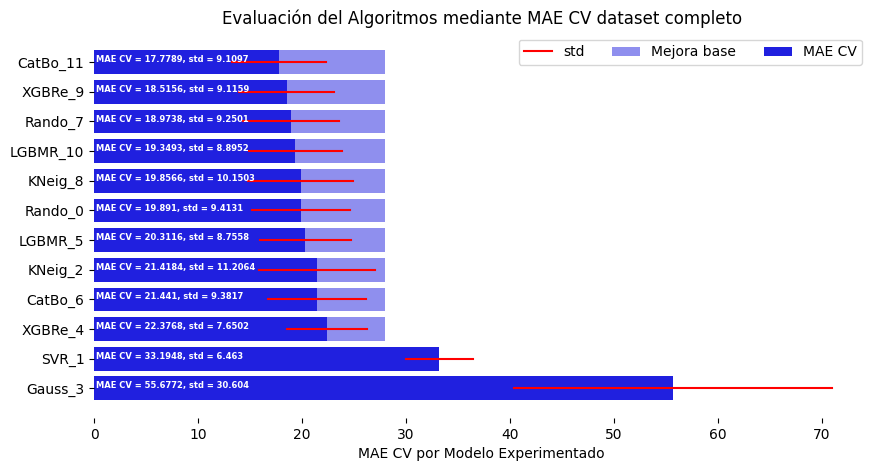

In [142]:
plot_results(summary_df.iloc[:12].sort_values(by = 'MAE CV'), 'MAE CV')

Se plotean los resultados para los modelos entrenados con el dataframe de SJ

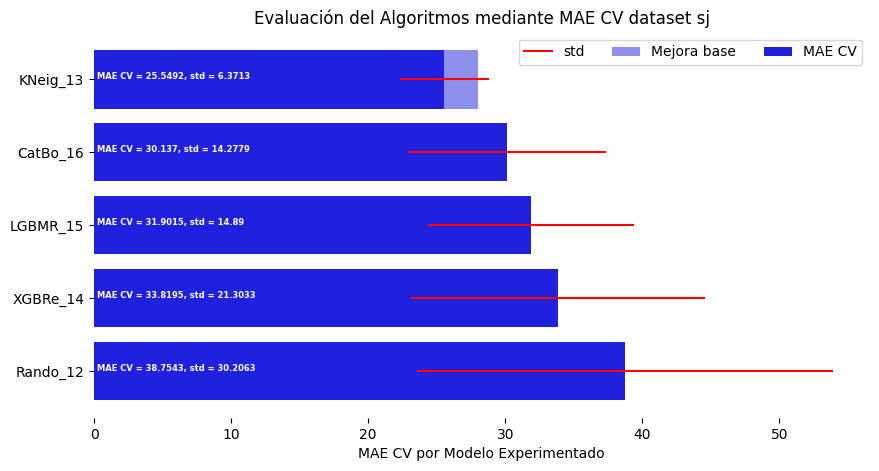

In [146]:
plot_results(summary_df.iloc[12:17].sort_values(by = 'MAE CV'), 'MAE CV', "sj")

Se plotean los resultados para los modelos entrenados con el dataframe de IQ

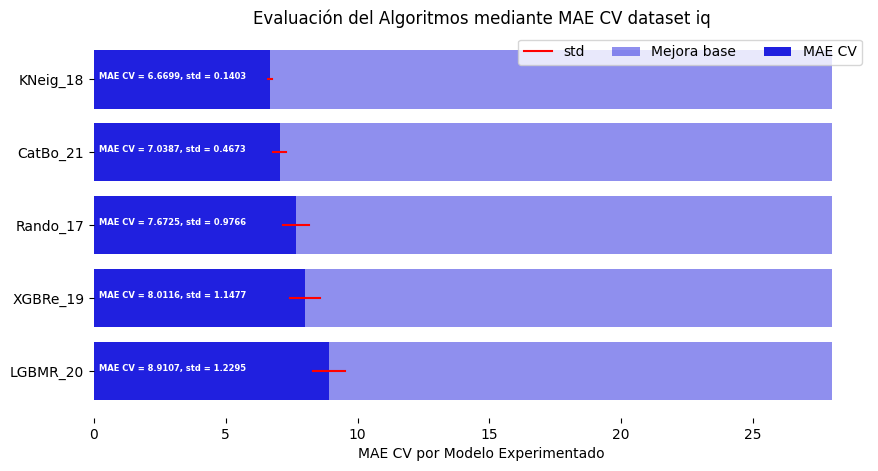

In [145]:
plot_results(summary_df.iloc[17:].sort_values(by = 'MAE CV'), 'MAE CV', 'iq')

**Observaciones para modelos probados con el dataset completo (índices 0-11):**

Se puede observar que el mejor modelo ha sido *CatBo_11* seguido de *Rando_7*. Sin embargo, no hay demasiada diferencia en los 5 primeros modelos, pudiendo ser cualquiera de ellos el mejor en una predicción sobre el test. 

Por lo tanto, se envían todos los modelos mejorados con el *AG* a la competición para realizar la comprobación de los resultados.

**Observaciones para modelos probados con el dataset filtrado por city == sj (índices 12-16):**
El mejor modelo pasa a ser *KNeig_13*, de la clase *KNeighborsRegressor*, cuando se entrena exclusivamente con datos de sj.

**Observaciones para modelos probados con el dataset filtrado por city == iq (índices 17-21):**
Curiosamente se repite el modelo de clase *KNeighborsRegressor*, con *KNeig_18*, cuando se entrena exclusivamente con datos de iq.

**IMPORTANTE**: no se pueden comparar todas la gráficas juntas, pues el *mae* es una métrica sujeta a la escala con la que se mide, y si para sj hay una incidencia diferente de casos totales que para iq, es natural que los resultados sean muy dispares y no se pueden comparar entre ellos ni con el modelo general con todos los datos.

Exportar CSV para competición por cada modelo mejorado por el AG con el dataset completo

In [51]:
#Se crea el dataframe de test procesado y normalizado
test_processed_norm = pd.DataFrame(x_min_max_scaler.transform(test_processed), columns = test_processed.columns)
#Por se itera por cada mejor modelo del AG
for model_name, values in best_models_from_AG.items():
    #Se extraen el modelo y las columnas a usar (ojo, el modelo está instanciado pero no entrenado)
    best_model = values[0]['model']
    cols_selected = values[0]['cols_selected'].copy()
    if model_name not in models_to_scale:
        #Se entrena el modelo y se predice y_test
        best_model.fit(X.loc[:,cols_selected], y) #Se entrena esta vez con todo el dataset
        y_test_pred = best_model.predict(test_processed.loc[:, cols_selected]) #Se predice
    else:
        #En este caso, antes de entrenar se tiene que escalar
        #Se escala X e y, luego se pasa a dataframe X para poder ser filtrado y enviado a evaluar
        X_norm = pd.DataFrame(x_min_max_scaler.transform(X), columns = X.columns)
        y_norm = y_min_max_scaler.transform(np.array(y).reshape(-1, 1))
        #Se entrena el modelo y se predice y_test escalado
        best_model.fit(X_norm.loc[:,cols_selected], y_norm)
        y_test_pred_scaled = best_model.predict(test_processed_norm.loc[:, cols_selected])
        #Ahora, se desescala
        y_test_pred = y_min_max_scaler.inverse_transform(y_test_pred_scaled.reshape(-1, 1))
    
    #Por último, antes de obtener los resultados definitivos, se convierten a enteros y se pasan los negativos a cero
    y_test_pred = np.array(y_test_pred).round(0).astype(int).ravel() #Ravel para hacerlo 1d
    y_test_pred = np.maximum(y_test_pred, 0) # REemplaza valores negativos por cero
    #Se muestran por pantalla algunas predicciones para comprobar que los valores tienen sentido
    print(f"Algunas predicciones del modelo {model_name}: {y_test_pred[:5]}")
    #Se descargan las predicciones
    download_predictions(test, y_test_pred, model_name) #Se añadirá el model_name al nombre de las predicciones

Algunas predicciones del modelo RandomForestRegressor: [5 5 5 6 8]
Downloaded practica2_pred_RandomForestRegressor20241108045241.csv
Algunas predicciones del modelo KNeighborsRegressor: [ 9  7 12  9 15]
Downloaded practica2_pred_KNeighborsRegressor20241108045241.csv
Algunas predicciones del modelo XGBRegressor: [ 9 10  9 27 10]
Downloaded practica2_pred_XGBRegressor20241108045241.csv
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000150 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1968
[LightGBM] [Info] Number of data points in the train set: 1446, number of used features: 15
[LightGBM] [Info] Start training from score 24.656985
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

Como segunda estrategia, se va a hacer lo mismo que antes pero con un postprocesado:
- Se va a predecir las etiquetas solo para city == sj con el algoritmo KNN
- Se va a predecir las etiquetas solo para city == iq con el algoritmo KNN
- Se unirán ambas predicciones para formar una predicción completa del dataset de test

In [139]:
def train_separately(X, y, value):
    global best_models_from_AG
    global test_processed_norm
    #Se selecciona el mejor modelo para sj
    best_model = best_models_from_AG['KNeighborsRegressor'][0]['model']
    cols_selected = best_models_from_AG['KNeighborsRegressor'][0]['cols_selected']
    #Se crea la instancia del modelo con los mejores parámetros
    #best_model_sj = best_model_sj(**selected_params_sj)
    #Se escala X_sj e y_sj para ser usado con el modelo KNeighborsRegressor
    X_norm = pd.DataFrame(x_min_max_scaler.transform(X), columns = X.columns)
    y_norm = y_min_max_scaler.transform(np.array(y).reshape(-1, 1))
    #Se entrena con el dataset de X_sj
    best_model.fit(X_norm.loc[:, cols_selected], y_norm)
    #Se obtiene el df de test para sj y se obtienen sus índices para más tarde usar de filtro
    test_proc_norm = test_processed_norm[test_processed_norm['city'] == value]
    ind_test = test_proc_norm.index.tolist()
    #Se predicen los sj
    y_pred_norm = best_model.predict(test_proc_norm.loc[:, cols_selected])
    #Se desescala
    y_pred = y_min_max_scaler.inverse_transform(y_pred_norm.reshape(-1, 1))
    return y_pred, ind_test

#Se obtienen las distintas predicciones
y_pred_sj, ind_test_sj = train_separately(X_sj, y_sj, 1)
y_pred_iq, ind_test_iq = train_separately(X_iq, y_iq, 0)

#Se unen ambas predicciones. Para ello, se crea y_pred y se calculará primero el tamaño de este
y_pred_size = max(max(ind_test_sj), max(ind_test_iq)) + 1
#Se crea el array con ceros
y_pred = np.zeros(y_pred_size)
#Se colocan los valores de y_pred_sj e y_pred_iq en sus posiciones
y_pred[ind_test_sj] = np.array(y_pred_sj).ravel()
y_pred[ind_test_iq] = np.array(y_pred_iq).ravel()

#Por último, antes de obtener los resultados definitivos, se convierten a enteros y se pasan los negativos a cero
y_pred = np.array(y_pred).round(0).astype(int).ravel() #Ravel para hacerlo 1d
y_pred = np.maximum(y_pred, 0) # Reemplaza valores negativos por cero
#Se muestran por pantalla algunas predicciones para comprobar que los valores tienen sentido
print(f"Algunas predicciones del modelo combinado: {y_pred[:5]}")
#Se descargan las predicciones
download_predictions(test, y_pred, "KNeighborsRegressor + 2") #Se añadirá el model_name al nombre de las predicciones



Algunas predicciones del modelo combinado: [ 9  7 12  9 15]
Downloaded practica2_pred_KNeighborsRegressor + 220241108165227.csv


Envío el modelo de Test a Competición. Se incluyen los restulados y se añaden al summary.

In [154]:
summary_df['MAE test (DrivenData)'][summary_df['Modelo'] == 'CatBo_11'] = 27.1418
summary_df['MAE test (DrivenData)'][summary_df['Modelo'] == 'Rando_7'] = 26.6731
summary_df['MAE test (DrivenData)'][summary_df['Modelo'] == 'LGBMR_10'] = 26.6442
summary_df['MAE test (DrivenData)'][summary_df['Modelo'] == 'KNeig_8'] = 26.7404
summary_df['MAE test (DrivenData)'][summary_df['Modelo'] == 'KNeig_13'] = 25.9327
summary_df['MAE test (DrivenData)'][summary_df['Modelo'] == 'KNeig_18'] = 25.9327

Se modifican las descripciones de los modelos para sj e iq

In [ ]:
#Se modifican la descripción del algoritmo para sj
description = summary_df['Descripción'][summary_df['Modelo'] == 'KNeig_13'].values[0]
description += " Se ha entrenado con el dataset correspondiente a la ciudad de sj exclusivamente"
summary_df['Descripción'][summary_df['Modelo'] == 'KNeig_13'] = description

In [160]:
#Se modifican la descripción del algoritmo para iq
description = summary_df['Descripción'][summary_df['Modelo'] == 'KNeig_18'].values[0]
description += " Se ha entrenado con el dataset correspondiente a la ciudad de iq exclusivamente"
summary_df['Descripción'][summary_df['Modelo'] == 'KNeig_18'] = description

---
# Conclusiones
---

A continuación, se expone la tabla resumen con los modelos y sus características (puntuaciones obtenidas, descripción de transformaciones, algoritmos usados, etc....).

Ojo, no para todos ellos hay una validación de test por las limitaciones de 3 al día de la web.

In [161]:
summary_df

,Modelo,MAE test (DrivenData),MAE CV,MAE CV std,Algoritmo,Hiperparámetros,Características,Descripción
0,Rando_0,None,19.890978,9.413129,RandomForestRegressor,"{'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}","[city, year, weekofyear, ndvi_ne, ndvi_nw, ndvi_se, ndvi_sw, reanalysis_air_temp_k, reanalysis_avg_temp_k, reanalysis_max_air_temp_k, reanalysis_min_air_temp_k, reanalysis_precip_amt_kg_per_m2, reanalysis_relative_humidity_percent, reanalysis_sat_precip_amt_mm, reanalysis_specific_humidity_g_per_kg, reanalysis_tdtr_k, station_avg_temp_c, station_diur_temp_rng_c, station_max_temp_c, station_min_temp_c, station_precip_mm, calc_ndvi_avg, calc_ndvi_range, calc_temp_range_c, calc_total_avg_air_temp, calc_avg_precip, Cluster_A, Cluster_C]","Transformaciones: \n - Eliminación de columnas ['week_start_date','precipitation_amt_mm', 'reanalysis_dew_point_temp_k']\n - Codificación de city en 0 y 1\n - Eliminación de instancias de más de un 50% de nulos en sus características\n - Relleno de nulos por la mediana o media según si tiene o no sesgo la característica y si tiene menos del 10% de nulos.\n - Relleno de nulos mediante regresión lineal para la característica ndvi_ne por tener más de un 10% de nulos.\n - Tratamiento de outliers sustituyéndolos por valores límites superiores (calculados en actividad 1).\n - Creación de nuevas características: ['calc_ndvi_avg', 'calc_ndvi_range', 'calc_temp_range_c', 'calc_total_avg_air_temp', 'calc_avg_precip']\n - Escalado entre 0 y 1 para clusterización\n - Clusterización en 3 clústeres mediante Gaussian Mixture Model\n - Eliminación del cluster ""B"" por correlación absoluta con la variable city\n"
1,SVR_1,None,33.194767,6.462950,SVR,"{'C': 1.0, 'cache_size': 200, 'coef0': 0.0, 'degree': 3, 'epsilon': 0.1, 'gamma': 'scale', 'kernel': 'rbf', 'max_iter': -1, 'shrinking': True, 'tol': 0.001, 'verbose': False}","[city, year, weekofyear, ndvi_ne, ndvi_nw, ndvi_se, ndvi_sw, reanalysis_air_temp_k, reanalysis_avg_temp_k, reanalysis_max_air_temp_k, reanalysis_min_air_temp_k, reanalysis_precip_amt_kg_per_m2, reanalysis_relative_humidity_percent, reanalysis_sat_precip_amt_mm, reanalysis_specific_humidity_g_per_kg, reanalysis_tdtr_k, station_avg_temp_c, station_diur_temp_rng_c, station_max_temp_c, station_min_temp_c, station_precip_mm, calc_ndvi_avg, calc_ndvi_range, calc_temp_range_c, calc_total_avg_air_temp, calc_avg_precip, Cluster_A, Cluster_C]","Transformaciones: \n - Eliminación de columnas ['week_start_date','precipitation_amt_mm', 'reanalysis_dew_point_temp_k']\n - Codificación de city en 0 y 1\n - Eliminación de instancias de más de un 50% de nulos en sus características\n - Relleno de nulos por la mediana o media según si tiene o no sesgo la característica y si tiene menos del 10% de nulos.\n - Relleno de nulos mediante regresión lineal para la característica ndvi_ne por tener más de un 10% de nulos.\n - Tratamiento de outliers sustituyéndolos por valores límites superiores (calculados en actividad 1).\n - Creación de nuevas características: ['calc_ndvi_avg', 'calc_ndvi_range', 'calc_temp_range_c', 'calc_total_avg_air_temp', 'calc_avg_precip']\n - Escalado entre 0 y 1 para clusterización\n - Clusterización en 3 clústeres mediante Gaussian Mixture Model\n - Eliminación del cluster ""B"" por correlación absoluta con la variable city\n \n- Escalado entre 0 y 1 para entrenamiento."
2,KNeig_2,None,21.418424,11.206360,KNeighborsRegressor,"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}","[city, year, weekofyear, ndvi_ne, ndvi_nw, ndvi_se, ndvi_sw, reanalysis

Para la observación del mejor modelo, se va a filtrar solo por ese y se traspondrá el dataset.

In [162]:
print("Modelo final Elegido:")
summary_df.sort_values(by = 'MAE test (DrivenData)').head(2).T

Modelo final Elegido:


,13,18
Modelo,KNeig_13,KNeig_18
MAE test (DrivenData),25.9327,25.9327
MAE CV,25.549198,6.669878
MAE CV std,6.371331,0.140316
Algoritmo,KNeighborsRegressor,KNeighborsRegressor
Hiperparámetros,"{'algorithm': 'auto', 'leaf_size': 10, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 15, 'p': 2, 'weights': 'distance'}","{'algorithm': 'auto', 'leaf_size': 10, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 15, 'p': 2, 'weights': 'distance'}"
Características,"[Cluster_C, reanalysis_air_temp_k, weekofyear, reanalysis_avg_temp_k, reanalysis_specific_humidity_g_per_kg, Cluster_A, calc_temp_range_c, station_max_temp_c, station_min_temp_c, reanalysis_relative_humidity_percent]","[Cluster_C, reanalysis_air_temp_k, weekofyear, reanalysis_avg_temp_k, reanalysis_specific_humidity_g_per_kg, Cluster_A, calc_temp_range_c, station_max_temp_c, station_min_temp_c, reanalysis_relative_humidity_percent]"
Descripción,"Transformaciones: \n - Eliminación de columnas ['week_start_date','precipitation_amt_mm', 'reanalysis_dew_point_temp_k']\n - Codificación de city en 0 y 1\n - Eliminación de instancias de más de un 50% de nulos en sus características\n - Relleno de nulos por la mediana o media según si tiene o no sesgo la característica y si tiene menos del 10% de nulos.\n - Relleno de nulos mediante regresión lineal para la característica ndvi_ne por tener más de un 10% de nulos.\n - Tratamiento de outliers sustituyéndolos por valores límites superiores (calculados en actividad 1).\n - Creación de nuevas características: ['calc_ndvi_avg', 'calc_ndvi_range', 'calc_temp_range_c', 'calc_total_avg_air_temp', 'calc_avg_precip']\n - Escalado entre 0 y 1 para clusterización\n - Clusterización en 3 clústeres mediante Gaussian Mixture Model\n - Eliminación del cluster ""B"" por correlación absoluta con la variable city\n \n- Escalado entre 0 y 1 para entrenamiento. Se ha entrenado con el dataset correspondiente a la ciudad de sj exclusivamente","Transformaciones: \n - Eliminación de columnas ['week_start_date','precipitation_amt_mm', 'reanalysis_dew_point_temp_k']\n - Codificación de city en 0 y 1\n - Eliminación de instancias de más de un 50% de nulos en sus características\n - Relleno de nulos por la mediana o media según si tiene o no sesgo la característica y si tiene menos del 10% de nulos.\n - Relleno de nulos mediante regresión lineal para la característica ndvi_ne por tener más de un 10% de nulos.\n - Tratamiento de outliers sustituyéndolos por valores límites superiores (calculados en actividad 1).\n - Creación de nuevas características: ['calc_ndvi_avg', 'calc_ndvi_range', 'calc_temp_range_c', 'calc_total_avg_air_temp', 'calc_avg_precip']\n - Escalado entre 0 y 1 para clusterización\n - Clusterización en 3 clústeres mediante Gaussian Mixture Model\n - Eliminación del cluster ""B"" por correlación absoluta con la variable city\n \n- Escalado entre 0 y 1 para entrenamiento. Se ha entrenado con el dataset correspondiente a la ciudad de iq exclusivamente"


La razón por la que aparecen dos modelos como "modelo escogido", es porque se ha utilizado la composición de ambos para realizar una sola predicción dividiendolo por ciudades.

Como explicación general de los experimentos descritos para todos los modelos:

- Se crean las clases de modelos a explocar en su forma por defecto.
- Se evalúan todos los modelos por defecto con la validación cruzada. Algunos se escalan entre 0 y 1, otros no. El elegido no se ha escalado.
- Se descartan aquellos con una puntuación *mae* por validación cruzada superior al límite base.
- El resto, se envían a optimizar mediante un *Algoritmo Genético*, donde se optimizan tanto los hiperparámetros del modelo como las características de entrenamiento.
- Se experimenta con el dataset dividido por ciudad para ver si los modelos predicen mejor por separado.
- Se envían los mejores modelos a la competición.

La elección del modelo ha sido determinada de una forma muy sencilla: aquel modelo que ha obtenido una mejor puntuación de test de *DrivenData*. Si se tuvieran otro tipo de limitantes como latencia, explicativdad, etc, puede que se hubiera escogido otro algoritmo de forma adaptativa al problema.

Como posibles mejoras, como ya se ha comentado anteriormente, se propone lo siguiente:
- Realizar reducción de características mediante *PCA*, *t-SNE* o *Autoencoders* para comprobar si no se ven afectados los resultados debido a la pérdida de varianza (info) y así reducir la latencia del modelo.
- Comprobar diferentes estrategias de tratamientos de outliers, como por ejemplo, en lugar de llevar todos los outliers extremos al límite superior establecido, llevar solo aquellos que no tengan concordancia con los outliers de la variable objetivo. Este estudio no se ha realizado y podría ser un punto de mejora (o no).
- Probar modelos más avanzados como redes neuronales profundas.
- Aumentar la cantidad de individuos en la población del algoritmo genético para modelos más livianos.

Cualquiera de estas estrategias o combinación de las mismas, podrían resultar en una mejor puntuación en la competición.

---
# Competición
---

Puntuaciones obtenidas con los modelos descritos:

**Usuario: cgbbigdata**

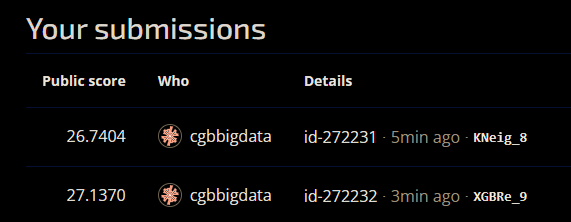

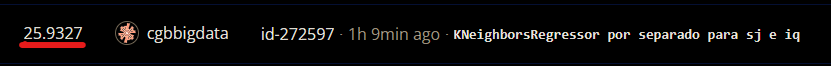

**Usuario: cristian.guerrerobalber**

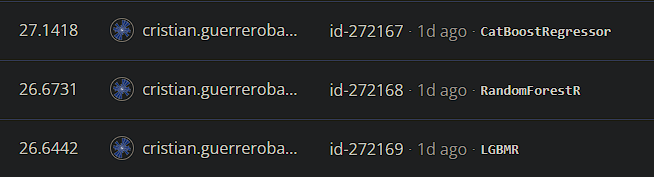

**CURIOSIDAD**

Experimentando con *RandomForestRegressor* y validación simple de *train* y *test* partidos en conjuntos pero sin fijar semilla aleatoria y llamando al algoritmo genético (configurado, entonces, con una validación simple), conseguí una mejor puntuación:

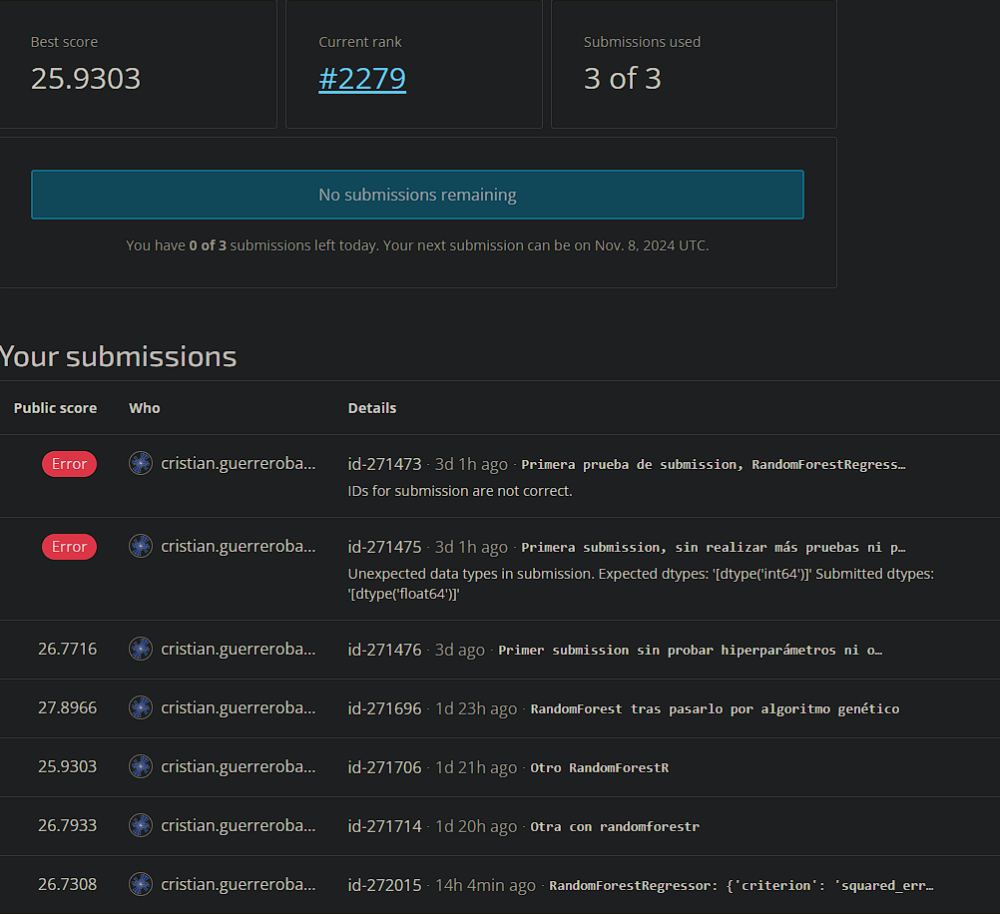

Por desgracia, al no haber fijado semilla entonces, no fui capaz de replicar el experimento y siempre obtuve puntuaciones mejores. Sin embargo, esto me da una idea de que el dataset tiene una buena ingeniería de características y que, jugando con el modelo *RandomForestRegressor* (el más pesado), con suficientes pruebas sería capaz de conseguir una mejor puntuación que las presentadas.